<center> <img src="https://media.springernature.com/lw685/springer-static/image/chp%3A10.1007%2F978-3-030-39364-9_5/MediaObjects/489541_1_En_5_Fig3_HTML.png" width=50% > </center>

<br><br>

<center> 
    <font size="6">Lab 2: Neighborhood Processing, Low-level Filters & Applications in image processing</font> 
</center>
<center> 
    <font size="4">Computer Vision 1 University of Amsterdam</font> 
</center>
<center> 
    <font size="4">Due 23:59, September 20, 2024 (Amsterdam time)</font> 
</center>
<center> 
    <font size="4"><b>TA's: Ronny, Owen, Oliver</b></font>
</center>

<br><br>

***

<br><br>

<center>

Student1 ID: 13426192 \
Student1 Name: Emma Kasteleyn

Student2 ID: 13854577 \
Student2 Name: Jasper van der Valk

Student3 ID: 15552055 \
Student3 Name: Platon Karageorgis

</center>

### **Import Libraries**

In [1]:
import sys

if sys.version_info[0] < 3:
    raise Exception("Python 3 or a more recent version is required.")

In [2]:
# environment and libraries
import os
import math
import numpy as np
import time
import cv2
import matplotlib
import matplotlib.pyplot as plt
import sklearn
import scipy.signal
import pandas as pd
from tqdm import tqdm

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

In [3]:
# Make sure you're using the provided environment!
assert cv2.__version__ == "4.10.0", "You're not using the provided Python environment!"
assert np.__version__ == "1.26.4", "You're not using the provided Python environment!"
assert matplotlib.__version__ == "3.9.2", "You're not using the provided Python environment!"
# Proceed to the next cell if you don't get any error.

### **Instructions**

Your code and discussion must be handed in this jupyter notebook, renamed to **StudentID1_StudentID2_StudentID3.ipynb** before the deadline by submitting it to the Canvas Lab 2 Assignment. Please also fill out your names and ID's above.

For full credit, make sure your notebook follows these guidelines:
- It is mandatory to **use the Python environment provided** with the assignment; the environment specifies the package versions that have to be used to prevent the use of particular functions. Using different packages versions may lead to grade deduction. In the Python cell above you can check whether your environment is set up correctly.
- To install the environment with the right package versions, use the following command in your terminal: ```conda env create --file=CV1_environment.yaml```, then activate the environment using the command ```conda activate cv1```.
- Do not use additional packages or materials that have not been provided or explicitly mentioned.
- Please express your thoughts **concisely**. The number of words does not necessarily correlate with how well you understand the concepts.
- Answer all given questions and sub-questions.
- Try to understand the problem as much as you can. When answering a question, give evidences (qualitative and/or quantitative results, references to papers, figures etc.) to support your arguments. Note that not everything might be explicitly asked for and you are expected to think about what might strengthen you arguments and make the notebook self-contained and complete.
- Tables and figures must be accompanied by a **brief** description. Do not forget to add a number, a title, and if applicable name and unit of variables in a table, name and unit of axes and legends in a figure.

__Note:__ A more complete overview of the lab requirements can be found in the Course Manual on Canvas

Late submissions are not allowed. Assignments that are submitted after the strict deadline will not be graded. In case of submission conflicts, TAs’ system clock is taken as reference. We strongly recommend submitting well in advance, to avoid last minute system failure issues.

Plagiarism note: Keep in mind that plagiarism (submitted materials which are not your work) is a serious crime and any misconduct shall be punished with the university regulations. This includes the use of generative tools such as ChatGPT.

**ENSURE THAT YOU SAVE ALL RESULTS / ANSWERS ON THE QUESTIONS (EVEN IF YOU RE-USE SOME CODE).**

### **Overview**

- [Section 1: Neighborhood Processing for Image Processing (3 points)](#section-1)
  - [Question 1 (2 points)](#question-1)
  - [Question 2 (1 points)](#question-2)
- [Section 2: Low-Level Gaussian Filters (11 points)](#section-2)
  - [Question 3 (2 points)](#question-3)
  - [Question 4 (3 points)](#question-4)
  - [Question 5 (1 point)](#question-5)
  - [Question 6 (2 points)](#question-6)
  - [Question 7 (1 point)](#question-7)
  - [Question 8 (2 points)](#question-8)
- [Section 3: Low-Level Gabors Filters (15 points)](#section-3)
  - [Question 9 (6 points)](#question-9)
  - [Question 10 (1 point)](#question-10)
  - [Question 11 (1 point)](#question-11)
  - [Question 12 (1 point)](#question-12)
  - [Question 13 (6 points)](#question-13)
- [Section 4: Noise in digital images (28 points)](#section-4)
  - [Question 14 (2 points)](#question-14)
  - [Question 15 (4 points)](#question-15)
  - [Question 16 (1 point)](#question-16)
  - [Question 17 (1 point)](#question-17)
  - [Question 18 (3 points)](#question-18)
  - [Question 19 (2 points)](#question-19)
  - [Question 20 (2 points)](#question-20)
  - [Question 21 (3 points)](#question-21)
  - [Question 22 (2 points)](#question-22)
  - [Question 23 (2 points)](#question-23)
  - [Question 24 (3 points)](#question-24)
  - [Question 25 (2 points)](#question-24)
- [Section 5: Edge Detection (20 points)](#section-5)
  - [Question 26 (4 points)](#question-26)
  - [Question 27 (3 points)](#question-27)
  - [Question 28 (4 point)](#question-28)
  - [Question 29 (1 points)](#question-29)
  - [Question 30 (2 points)](#question-30)
  - [Question 31 (2 points)](#question-31)
  - [Question 32 (2 points)](#question-32)
  - [Question 33 (2 points)](#question-33)
- [Section 6: Foreground-background separation (24 points)](#section-6)
  - [Question 33 (8 points)](#question-33)
  - [Question 34 (8 points)](#question-34)
  - [Question 35 (4 points)](#question-35)
  - [Question 36 (4 points)](#question-36)
- [Section X: Individual Contribution Report (Mandatory)](#section-x)

<a id="section-1"></a>
### **Section 1: Neighborhood Processing for Image Processing**

This assignment will start with an exploration of neighborhood processing techniques, which are fundamental to image processing. These techniques allow for the extraction of structural patterns such as edges and blobs, and are extensively used in tasks like image denoising and segmentation. Neighborhood or block processing is also a key component of Convolutional Neural Networks.

Neighborhood processing involves examining the pixels surrounding a point $I(x, y)$ in an image $I$ and applying a function, $h(k, l)$, that measures specific properties or relationships within that local window. This function, $h(k, l)$, is known as the neighborhood operator or local operator, and is often implemented as a linear filter.

Linear filters compute a weighted sum of the neighboring pixel intensities and assign this sum to the pixel of interest, producing the output $I_{out}(i, j)$. These filters are typically represented as square matrices. Terms like filters, kernels, weight matrices, or masks are often used interchangeably in the literature. A kernel is a matrix that defines a neighborhood operation, such as edge detection or smoothing.

Linear filters are applied across the entire image using operators like correlation ($\otimes$) and convolution ($\ast$).\

Both operators are *linear shift-invariant* (LSI), meaning they function consistently across the image. The discrete forms of these operators are expressed as follows:

- **Correlation (1)**:

$\mathbf{I}_{out} = I \otimes  \mathbf{h} \\
\mathbf{I}_{out}(i,j) = \sum_{k,l}  \mathbf{I}(i+k,j+l) \mathbf{h}(k,l)$

- **Convolution (2)**:

$\mathbf{I}_{out} = \mathbf{I} \ast  \mathbf{h} \\
\mathbf{I}_{out}(i,j) = \sum_{k,l} \mathbf{I}(i-k,j-l) \mathbf{h}(k,l)$

The following example illustrates neighborhood processing: a kernel or mask convolves over the input image, with each pixel intensity multiplied by the corresponding weight in the kernel. The example uses a $3x3$ averaging mask, showing the effect of filtering on the input image.

<div>
<img src="https://assets.8thlight.com/images/insights/posts/2022-03-25-what-is-a-convolution/padding_example.png" width="700"/>
</div>

<a id="question-1"></a>
#### <font color='#FF0000'>Question 1 (2 points)</font>

What is the difference between correlation and convolution operators? How do they treat the signals $\mathbf{I}$ and $\mathbf{h}$?

##### <font color='yellow'>Answer:</font>

The difference between the correlation and convolution operator is that correlation takes the pixels after i and j and multiplies this with the neighborhoud operator, while the convolation takes the pixels before i and j and multiplies this with the neightborhood operator, thus flipping the filter. In the convolution case, the neighborhood operator can also be called the impulse response function, because it reproduces itself if multiplied by an impulse signal (the input is zero everywhere except the origin). The correlation produces the reflected signal. This means that convolution can also be written as: $\sum_{k,l} \boldsymbol{I}(i-k,j-l)\boldsymbol{h}(k,l)=\sum_{k,l} \boldsymbol{I}(k,l)\boldsymbol{h}(i-k,j-l)$.

<a id="question-2"></a>
#### <font color='#FF0000'>Question 2 (1 point)</font>

Correlation and convolution operators are equivalent when we make an assumption on the form of the mask $\mathbf{h}$. Can you identify the case? Give precise answer here.

##### <font color='yellow'>Answer:</font>

If we assume that the neighborhoud operator $\boldsymbol{h}$ is symmetrix, we get $\boldsymbol{h}(k,l)=\boldsymbol{h}(-k,-l)$, which makes flipping this filter the same as not flipping it. This makes the correlation and convolution operators equivalent.

<a id="section-2"></a>
### **Section 2: Low-Level Gaussian Filters**

In this section, you will design common linear filters used in neighborhood processing. We will focus in on Gaussian filters, which are widely used for image smoothing and noise reduction.

<a id="question-3"></a>
#### <font color='#FF0000'>Question 3 (2 points)</font>

The 1D Gaussian filter is defined as follows:

$G_{\sigma}(x)=\frac{1}{\sigma\sqrt{2\pi}}\text{ exp}(-\frac{x^2}{2\sigma^2})$

where $\sigma$ is the standard deviation of the Gaussian. However, such a formulation creates an infinitely large convolution kernel. In practice, the kernel is truncated with a `kernel_size` parameter such that $-\left\lfloor \frac{kernel\_size}{2}\right\rfloor \leq x \leq \left\lfloor \frac{kernel\_size}{2} \right\rfloor$, where $\left\lfloor \cdot \right\rfloor$ is the floor operator. For example, if `kernel_size` equals 3, then $x \in \{ -1, 0, 1 \}$.

Now, implement the following function `gaussian_kernel_1D`.

**Hint:** Do not forget to normalize your filter.

**Note:** You are not allowed to use any Python built-in functions provided by *SciPy* or other libraries to compute the kernel.

In [4]:
def gaussian_kernel_1D(sigma, kernel_size):
    '''
    Computes a 1D Gaussian kernel.

    Args:
        sigma: Standard deviation of the Gaussian distribution.
        kernel_size: The size of the kernel, must be an odd positive integer.

    Returns:
        kernel: A 1D numpy array representing the Gaussian kernel, normalized so that the sum of all elements equals 1.
    '''

    kernel = np.zeros((1, kernel_size))

    if kernel_size % 2 == 0:
        raise ValueError("The kernel size must be an odd number. Otherwise, the kernel will not have a center to convolve around.")

    size = kernel_size//2
    x = np.arange(-size,size+1)
    kernel = 1/(sigma*np.sqrt(2*np.pi))*np.exp(-(x**2)/(2*sigma**2))
    kernel = kernel/np.sum(kernel)

    return kernel

In [5]:
G = gaussian_kernel_1D(2, 5)
print(G)

[0.15246914 0.2218413  0.25137912 0.2218413  0.15246914]


<a id="question-4"></a>
#### <font color='#FF0000'>Question 4 (3 points)</font>

One of the most important properties of 2D Gaussian kernels is separability. This means that convolving an image with a 2D Gaussian kernel is equivalent to convolving the image twice with a 1D Gaussian filter: once along the x-axis and once along the y-axis, **separately**. A 2D Gaussian kernel can then be defined as the product of two 1D Gaussian kernels:

$G_{\sigma}(x, y) = G_{\sigma}(x) \times G_{\sigma}(y)$ *(Equation A)*

This is mathematically equivalent to:

$G_{\sigma}(x, y) = \frac{1}{\sigma^2 2\pi}\text{ exp}(-\frac{x^2 + y^2}{2\sigma^2})$ *(Equation B)*

Implement the `gaussian_kernel_2D` function that corresponds to *Equation A*. You should make use of the previously implemented `gaussian_kernel_1D` function.

**Note:** You are not allowed to use any Python built-in functions provided by *SciPy* or other libraries to compute the kernel.

In [6]:
def gaussian_kernel_2D(sigma_x, sigma_y, kernel_size):
    '''
    Computes a 2D Gaussian kernel using the separability property.

    Args:
        sigma_x: Standard deviation of the Gaussian distribution along the x-axis.
        sigma_y: Standard deviation of the Gaussian distribution along the y-axis.
        kernel_size: The size of the kernel, must be an odd positive integer.

    Returns:
        kernel_2d: A 2D numpy array representing the Gaussian kernel, normalized so that the sum of all elements equals 1.
    '''
    x = gaussian_kernel_1D(sigma_x, kernel_size)
    y = gaussian_kernel_1D(sigma_y, kernel_size)

    kernel_2d = np.outer(x,y)
    kernel_2d = kernel_2d/np.sum(kernel_2d)

    return kernel_2d

In [7]:
G = gaussian_kernel_2D(2, 2, 3)
print(G)

[[0.10186806 0.11543164 0.10186806]
 [0.11543164 0.13080118 0.11543164]
 [0.10186806 0.11543164 0.10186806]]


<a id="question-5"></a>
#### <font color='#FF0000'>Question 5 (1 point)</font>

Consider the following two scenarios:

1. An image is convolved with a 2D Gaussian kernel.
2. The same image is convolved first with a 1D Gaussian kernel along the x-axis and then with a 1D Gaussian kernel along the y-axis.

Will these two scenarios produce the same result? Explain your answer.

##### <font color='yellow'>Answer:</font>

These two scenarios will produce the same result if the 2D kernel is seperable. This is the case for a Gaussian kernel, as stated earlier where: $G_{\sigma}(x, y) = G_{\sigma}(x) \times G_{\sigma}(y)$. Then, we can split the 2D kernel $\boldsymbol{K}$ in a horizontal kernel $\boldsymbol{h}$ and a vertical kernel $\boldsymbol{v}$. If we take the outer product, we get $\boldsymbol{K}$ back: $\boldsymbol{K}=\boldsymbol{v}\boldsymbol{h}^T$. 

<a id="question-6"></a>
#### <font color='#FF0000'>Question 6 (2 points)</font>

What is the computational complexity for both scenarios described in Question 5? Provide your answer in Big O notation, using *n* for the width of the image, *m* for the height of the image, and *k* for the size of the kernel.

##### <font color='yellow'>Answer:</font>

The computational complexity for scenario 1 lies in the fact that a 2D Gaussian kernel needs $k^2$ operations per pixel, thus $n\cdot m \cdot k^2$ operations. This is computationally intensive. Scenario two can split this process in first performing 1D horizontal convolution, and then performing 1D vertical convolution, thus only performing $2n\cdot m\cdot k$ operations. This is computationally less complex.

<a id="question-7"></a>
#### <font color='#FF0000'>Question 7 (1 point)</font>

So far, the Gaussian kernels that we have computed are primarily used for image enhancement tasks, such as denoising. However, these kernels can also be used to detect changes in image intensity, which are crucial for identifying low-level features. These features can then serve as building blocks for more complex tasks like object detection or segmentation.

The first-order derivative of the 1D Gaussian kernel is given by:

$\frac{d}{dx}G_\sigma(x)  =\frac{d}{dx}\left( \frac{1}{\sigma\sqrt{2\pi}}\exp\left(-\frac{x^2}{2\sigma^2}\right) \right)$

$ = -\frac{x}{\sigma^3\sqrt{2\pi}}\exp\left(-\frac{x^2}{2\sigma^2}\right)$ *(Eq. C)*

$ = -\frac{x}{\sigma^2}G_\sigma(x)$

Similarly, the first-order derivative of the 2D Gaussian kernel can be obtained by computing $\frac{d}{dx}G_\sigma(x,y)$ and $\frac{d}{dy}G_\sigma(x,y)$.

Determine the first-order derivative of the 2D Gaussian kernel by computing $\frac{d}{dx}G_\sigma(x,y)$ and $\frac{d}{dy}G_\sigma(x,y)$.

Show your calculations, as done above for $\frac{d}{dx}G_\sigma(x)$.

Remember that:

$G_{\sigma}(x, y) =\frac{1}{\sigma^2 2\pi}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right)$

##### <font color='yellow'>Answer:</font>

$\frac{d}{dx}G_\sigma(x,y) = \frac{d}{dx} \left( \frac{1}{\sigma\sqrt{2\pi}}\exp\left(-\frac{x^2+y^2}{2\sigma^2}\right) \right)$

$= \frac{1}{\sigma\sqrt{2\pi}}\exp\left(-\frac{x^2+y^2}{2\sigma^2}\right) \cdot \left(-\frac{x}{\sigma^2}\right) $

$= -\frac{x}{\sigma^4 2\pi}\exp \left(-\frac{x^2+y^2}{2\sigma^2}\right)$

$\frac{d}{dy}G_\sigma(x,y) = \frac{d}{dy} \left( \frac{1}{\sigma\sqrt{2\pi}}\exp\left(-\frac{x^2+y^2}{2\sigma^2}\right) \right)$

$= \frac{1}{\sigma\sqrt{2\pi}}\exp\left(-\frac{x^2+y^2}{2\sigma^2}\right) \cdot \left(-\frac{y}{\sigma^2}\right) $

$= -\frac{y}{\sigma^4 2\pi}\exp \left(-\frac{x^2+y^2}{2\sigma^2}\right)$

<a id="question-8"></a>
#### <font color='#FF0000'>Question 8 (2 points)</font>

The second-order derivative of the Gaussian kernel can also be computed. Why is it useful to design a second-order kernel? Provide one example where it is more beneficial to use a second-order derivative Gaussian kernel compared to a first-order derivative Gaussian kernel, and explain how it can be used.

##### <font color='yellow'>Answer:</font>

It is useful to design a second-order kernel, because this kernel reports rapid changes in intensity. The first-order derivative is known to report slopes, while the second-order derivative reports acceleration. This makes the second-order derivative useful to find these rapid changes, to for example detect edges (rapid intensity change). It would be more useful to use a second-order instead of a first-order derivative Gaussian kernel in this case. An example could be to detect objects, thus we need to find the edges. The second-order derivative finds the zero-crossings, which is easier to detect than the simple peak a first-order derivative finds.

<a id="section-3"></a>
### **Section 3: Low-Level Gabors Filters**

In this section, we will explore Gabor filters, which are widely used in image processing for edge detection, texture analysis, and feature extraction. Gabor filters are based on the Gabor wavelet, which is a sinusoidal wave modulated by a Gaussian function.

Gabor filters fall into the category of linear filters and are widely used for *texture analysis*. The reason why they are a good choice for texture analysis is that they localize well in the frequency spectrum (*optimally* bandlimited) and therefore work as flexible *band-pass* filters.

In the following image you can see even (cosine-modulated) and odd parts (sine-modulated) of Gabor filters with fixed-σ Gaussian. You can observe time-domain filters for the modulating sinusoidals of central frequencies, 10, 20, 30, 40 and 50 Hz, respectively.

<img src="https://drive.google.com/thumbnail?id=1wv6ZUOfiHMDgg0jW7n5lqkaFiFztjnEo&sz=w800">

Gabor filters with varying center frequencies are sensitive to different frequency bands. Notice that the neighboring (in the frequency spectrum) filters minimally interfere with each other.

<img src="https://drive.google.com/thumbnail?id=1hUQaKE_TwC-9_jMIao1CCxyjembMrUab&sz=w800">

<a id="question-9"></a>
#### <font color='#FF0000'>Question 9 (6 points)</font>

To understand Gabor functions, let's start with 1D signals (e.g., speech) and then generalize to the 2D case, which is more relevant for images. A Gabor function is essentially a Gaussian function modulated by a complex sinusoidal carrier signal. This can be expressed as:

$g(t) = x(t) \cdot m(t)$ *(Equation C)*

where $x(t) = \frac{1}{\sqrt{2\pi}\sigma} e^{-\frac{t^2}{2\sigma^2}}$ is the Gaussian function, and $m(t) = e^{j 2 \pi f_c t} = e^{j w_c t}$ is the complex sinusoidal carrier. Here, $\sigma$ controls the spread of the Gaussian, and $w_c$ is the central frequency of the carrier signal.

Using Euler's formula:

$e^{j w t} = \cos(w t) + j \sin(w t)$

we can rewrite the Gabor function as:

$g(t) = \frac{1}{\sqrt{2\pi}\sigma} e^{-\frac{t^2}{2\sigma^2}} \left[\cos(w_c t) + j \sin(w_c t)\right]$

This can be further broken down into:

$g(t) = g_e(t) + j g_o(t)$

where $g_e(t)$ and $g_o(t)$ are the even and odd parts of the function, arranged orthogonally on the complex plane. In practice, you can use either the even or odd part for filtering purposes, or the entire complex form.

In 2D, the concept extends with a sine wave described by two orthogonal spatial frequencies $u_0$ and $v_0$:

$s(x,y) = \sin(2\pi(u_0 x + v_0 y))$

and a 2D Gaussian:

$C \cdot \exp\left(-\left(\frac{(x-x_0)^2}{2\sigma_x^2} + \frac{(y-y_0)^2}{2\sigma_y^2}\right)\right)$

The 2D Gabor function then takes the following forms:

$g_{\text{real}}(x,y; \lambda, \theta, \psi, \sigma, \gamma) = \exp\left(-\frac{x^{\prime2}+\gamma^2 y^{\prime2}}{2\sigma^2}\right) \cos\left( 2\pi \frac{x^{\prime}}{\lambda} + \psi  \right)$

$g_{\text{im}}(x,y; \lambda, \theta, \psi, \sigma, \gamma) = \exp\left(-\frac{x^{\prime2}+\gamma^2 y^{\prime2}}{2\sigma^2}\right) \sin\left( 2\pi \frac{x^{\prime}}{\lambda} + \psi  \right)$

where:

$x^\prime = x\cos\theta + y\sin\theta$

$y^\prime = -x\sin\theta + y\cos\theta$

Here, $\lambda$, $\theta$, $\psi$, $\sigma$, and $\gamma$ are parameters that control the shape and size of the Gabor function.

In this question, you will design a Gabor filter bank, which is a collection of Gabor filters with different orientations and scales. To achieve this, you will have to implement the `create_gabor()` function. Before that, complete the following helper functions:

- `generate_rotation_matrix()`
- `create_cos()`
- `create_sin()`
- `create_gauss()`

Finally, use these helper functions within the `create_gabor()` function to construct the Gabor filters.

In [8]:
def generate_rotation_matrix(theta):
    '''
    Returns the rotation matrix for a given theta.
    
    Args:
        theta: Rotation parameter in radians.
    
    Returns:
        rot_matrix: Rotation matrix.
    '''

    # YOUR CODE HERE
    rot_matrix = np.array([
        [np.cos(theta), -np.sin(theta)],
        [np.sin(theta), np.cos(theta)]
    ])

    return rot_matrix

In [9]:
def create_cos(rot_x, lamda, psi):
    '''
    Returns the 2D cosine carrier.
    
    Args:
        rot_x: Rotated x-coordinates.
        lamda: Wavelength of the cosine function.
        psi: Phase offset.
    
    Returns:
        cos_carrier: 2D cosine carrier.
    '''

    # YOUR CODE HERE
    cos_carrier = np.cos(2*np.pi*rot_x/lamda + psi)

    return cos_carrier

In [10]:
def create_sin(rot_x, lamda, psi):
    '''
    Returns the 2D sine carrier.
    
    Args:
        rot_x: Rotated x-coordinates.
        lamda: Wavelength of the sine function.
        psi: Phase offset.
    
    Returns:
        sin_carrier: 2D sine carrier.
    '''

    # YOUR CODE HERE
    sin_carrier = np.sin(2*np.pi*rot_x/lamda + psi)

    return sin_carrier

In [11]:
def create_gauss(rot_x, rot_y, gamma, sigma):
    '''
    Returns the 2D Gaussian envelope.
    
    Args:
        rot_x: Rotated x-coordinates.
        rot_y: Rotated y-coordinates.
        gamma: Aspect ratio of the Gaussian envelope.
        sigma: Standard deviation of the Gaussian.
    
    Returns:
        gauss_env: 2D Gaussian envelope.
    '''

    # YOUR CODE HERE
    gauss_env = np.exp(- (np.power(rot_x, 2) + (gamma ** 2) * np.power(rot_y, 2)) / (2 * (sigma ** 2)))

    return gauss_env

In [12]:
def create_gabor(sigma, theta, lambda_, psi, gamma):
    '''
    Creates a complex-valued Gabor filter.
    
    Args:
        sigma: Standard deviation of the Gaussian envelope.
        theta: Orientation of the Gaussian envelope in the range [0, pi/2).
        lambda_: Wavelength of the carrier signal.
        psi: Phase offset for the carrier signal.
        gamma: Aspect ratio of the Gaussian envelope.
    
    Returns:
        my_gabor: A 3D array of shape [h, w, 2], where the first channel contains the real part and the second channel contains the imaginary part of the Gabor filter.
    '''

    # Set the aspect ratio.
    # YOUR CODE HERE
    sx = sigma
    sy = sigma/gamma

    # Generate a grid
    # YOUR CODE HERE
    n_std = 3
    x_max = np.max([np.abs(n_std*sx*np.cos(theta)), np.abs(n_std*sy*np.sin(theta)), 1])
    y_max = np.max([np.abs(n_std*sx*np.sin(theta)), np.abs(n_std*sy*np.cos(theta)), 1])
    

    # Make sure that we get square filters.
    # YOUR CODE HERE
    xy_max = int(np.ceil(np.max([x_max, y_max])))
    x_min = - xy_max
    y_min = - xy_max

    # Generate a coordinate system in the range [xmin, xmax] and [ymin, ymax].
    # YOUR CODE HERE
    x, y = np.meshgrid(np.arange(x_min, xy_max + 1), np.arange(y_min, xy_max + 1))

   
    # Convert to a 2-by-N matrix where N is the number of pixels in the kernel.
    # YOUR CODE HERE
    x_flat = x.flatten()
    y_flat = y.flatten()
    xy = np.vstack((x_flat, y_flat))

    # Compute the rotation of pixels by theta.
    # YOUR CODE HERE
    rot = generate_rotation_matrix(theta)
    xy_hat = rot@xy
    
    # Create the Gaussian envelope.
    # YOUR CODE HERE
    rot_x = xy_hat[0, :].reshape(x.shape)
    rot_y = xy_hat[1, :].reshape(x.shape)
    gauss_env = create_gauss(rot_x, rot_y, gamma, sigma)

    # Create the orthogonal carrier signals.
    # YOUR CODE HERE
    cos_carrier = create_cos(rot_x, lambda_, psi)
    sin_carrier = create_sin(rot_x, lambda_, psi)

    # Modulate (multiply) Gaussian envelope with the carriers to compute
    # the real and imaginary components of the complex Gabor filter.
    # YOUR CODE HERE
    g_real = gauss_env*cos_carrier
    g_im = gauss_env*sin_carrier

    # Pack my_gabor_real and my_gabor_imaginary into my_gabor.
    # YOUR CODE HERE
    my_gabor = np.zeros((xy_max*2 + 1, xy_max*2 + 1, 2))
    my_gabor[:, :, 0] = g_real
    my_gabor[:, :, 1] = g_im

    return my_gabor

<a id="question-10"></a>
#### <font color='#FF0000'>Question 10 (1 point)</font>

Visualize how the parameter $\theta$ affects the Gabor filter in the spatial domain. Use the following steps:

1. Initialize the parameters as follows: $\lambda = 30$, $\theta = 0$, $\psi = 0$, $\sigma = 10$, $\gamma = 0.25$.
2. Set $\theta$ to $0$, $\pi/4$, and $\pi/2$ while keeping the other parameters unchanged.
3. Generate and display the Gabor filters corresponding to each value of $\theta$.
4. Ensure that each image in the visualization is clearly labeled to indicate the value of $\theta$ it represents.

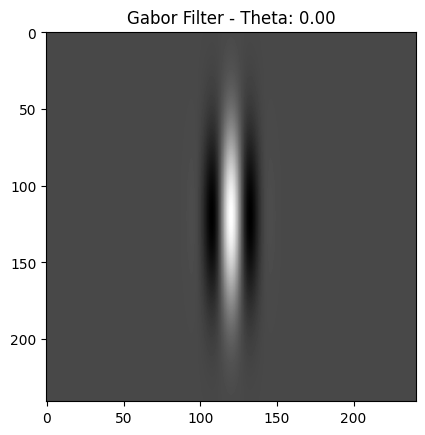

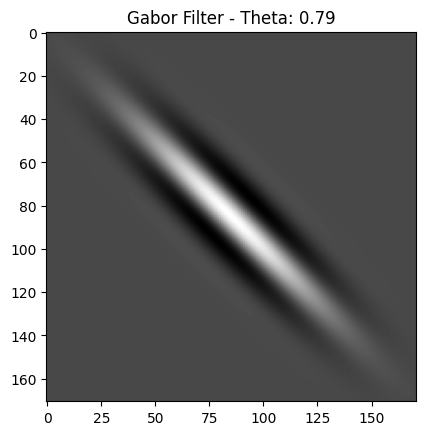

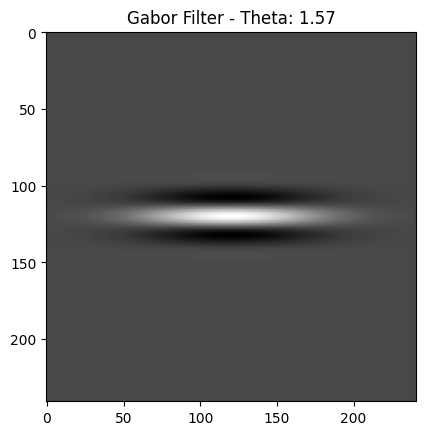

In [13]:
lamda, theta_in, psi, sigma, gamma = 30, 0, 0, 10, 0.25
theta = np.array([0, np.pi/4, np.pi/2])
for i in range(len(theta)):
    gabor_filter = create_gabor(sigma, theta[i], lamda, psi, gamma)
    gabor_real = gabor_filter[:, :, 0]
    plt.imshow(gabor_real, cmap='gray')
    plt.title(f'Gabor Filter - Theta: {theta[i]:.2f}')
    plt.show()

<a id="question-11"></a>
#### <font color='#FF0000'>Question 11 (1 point)</font>

Visualize how the parameter $\sigma$ affects the Gabor filter in the spatial domain. Use the following steps:

1. Initialize the parameters as follows: $\lambda = 35$, $\theta = \pi/6$, $\psi = \pi/4$, $\sigma = 10$, $\gamma = 0.5$.
2. Set $\sigma$ to $10$, $30$, and $45$ while keeping the other parameters unchanged.
3. Generate and display the Gabor filters corresponding to each value of $\sigma$.
4. Ensure that each image in the visualization is clearly labeled to indicate the value of $\sigma$ it represents.

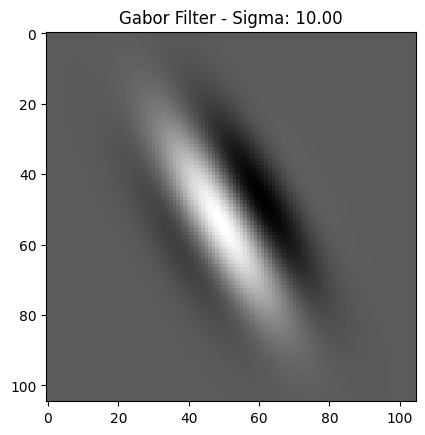

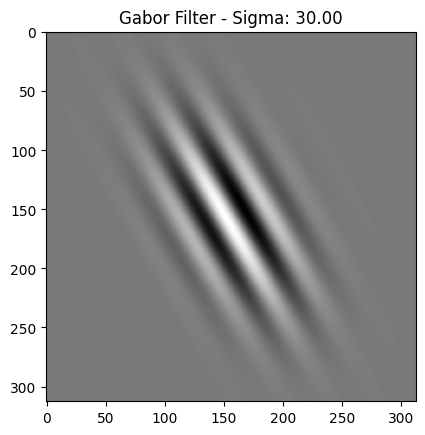

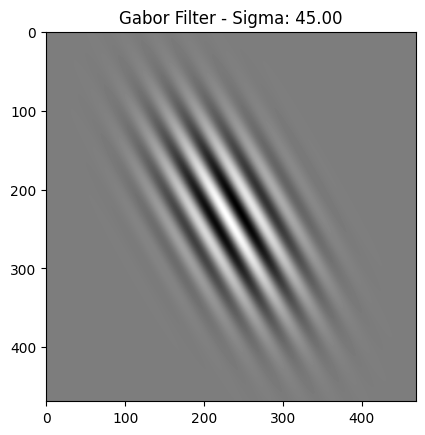

In [14]:
lamda, theta, psi, sigma_in, gamma = 35, np.pi/6, np.pi/4, 10, 0.5
sigma = np.array([10, 30, 45])
for i in range(len(sigma)):
    gabor_filter = create_gabor(sigma[i], theta, lamda, psi, gamma)
    gabor_real = gabor_filter[:, :, 0]
    plt.imshow(gabor_real, cmap='gray')
    plt.title(f'Gabor Filter - Sigma: {sigma[i]:.2f}')
    plt.show()

<a id="question-12"></a>
#### <font color='#FF0000'>Question 12 (1 point)</font>

Visualize how the parameter $\gamma$ affects the Gabor filter in the spatial domain. Use the following steps:

1. Initialize the parameters as follows: $\lambda = 25$, $\theta = \pi/3$, $\psi = \pi/6$, $\sigma = 8$, $\gamma = 0.75$.
2. Set $\gamma$ to $.25$, $.50$, and $.75$ while keeping the other parameters unchanged.
3. Generate and display the Gabor filters corresponding to each value of $\gamma$.
4. Ensure that each image in the visualization is clearly labeled to indicate the value of $\gamma$ it represents.


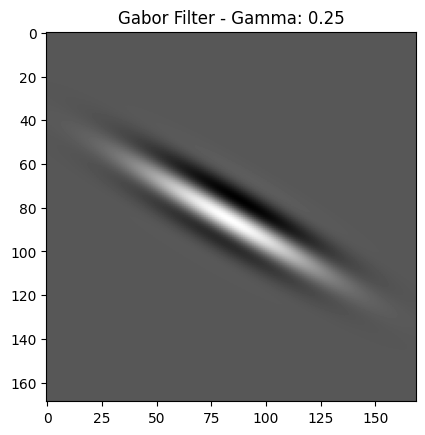

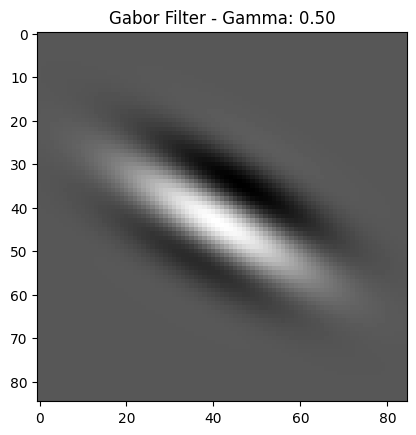

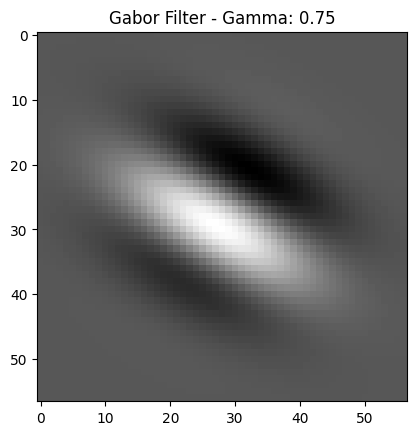

In [15]:
lamda, theta, psi, sigma, gamma_in = 25, np.pi/3, np.pi/6, 8, 0.75
gamma = np.array([0.25, 0.5, 0.75])
for i in range(len(gamma)):
    gabor_filter = create_gabor(sigma, theta, lamda, psi, gamma[i])
    gabor_real = gabor_filter[:, :, 0]
    plt.imshow(gabor_real, cmap='gray')
    plt.title(f'Gabor Filter - Gamma: {gamma[i]:.2f}')
    plt.show()

<a id="question-13"></a>
#### <font color='#FF0000'>Question 13 (6 points)</font>

Based on the visualizations of parameters and your self-study on Gabor filters, explain briefly:

1. What do the parameters $\lambda$, $\theta$, $\psi$, $\sigma$, and $\gamma$ control?
2. How do these parameters visually influence the Gabor filter kernel?

##### <font color='yellow'>Answer:</font>

### 1. What do the parameters λ, θ, ψ, σ, γ control?
#### λ (Wavelength):
This parameter sets how far apart the stripes are in the Gabor filter's pattern. It controls the spacing of these stripes, which changes how the filter responds to different levels of detail in the image. Increasing its value results in thicker stripes.

#### θ (Orientation):
This sets the angle of the stripes in the filter. It changes which direction the filter is most sensitive to when looking for edges or textures in the image.

#### ψ (Phase Offset):
This parameter shifts the phase of the sinusoidal function. It affects where the sine wave starts, adjusts its phase, and alters the symmetry of the filter.

#### σ (Standard Deviation):
σ controls the width of the Gaussian envelope, affecting the extent of the filter. While σ grows larger, it makes the filter cover more area which as a result makes the image smoother.

#### γ (Aspect Ratio):
This changes the shape of the filter. It can stretch or compress the pattern of the image. If we set a smaller value, the filter is more stretched out. Bigger values have the opposite results. Also, these changes assist in the detection of details in certain directions. 

### 2. How do these parameters visually influence the Gabor filter kernel?
#### λ (Wavelength):
Smaller λ means the stripes are packed tightly together, while larger λ makes them more spread out. By setting a big value for λ (it's not on the above images so we will explain it) we get a thicker image, while in the opposite case it looks like a vertical pole.

#### θ (Orientation):
Changing θ rotates the pattern, which is made clear by looking at the illustrations above. We notice that when we set it to 0 it is vertical, whilst in the case that we set it as 1.57 (π/2), it normally rotates 90 degrees and becomes horizontal.

#### ψ (Phase Offset):
By plotting ψ visually we see that the alteration lies mainly in the colors of the plot. We see that for ψ=π we get a brighter image and for the exact opposite value, ψ=2π we get a darker image that essentially switched the colors of the previous case. The explanation lies in the shift in the sinusoidal function.

#### σ (Standard Deviation):
A larger σ makes the filter cover more of the image, picking up broader patterns, while a smaller σ makes it more focused and sensitive to fine details. We can see that for σ=10 the resulting image looks like it depicts a single object while in the last case where it is 45, it broadens, and therefore makes the stripes clearer.

#### γ (Aspect Ratio):
A low aspect ratio causes a more anisotropic result (which is apparent especially in the first image), while we notice that for γ=0.75 the image is much more balanced. Setting γ=1 illustrates a result that is almost completely round and isotropic.

<a id="section-4"></a>
### **Section 4: Noise in digital images**

Digital images are often plagued by various types of noise that can significantly degrade their quality. These imperfections might originate during the image acquisition process, where sensors introduce noise, or through user errors, such as incorrect camera settings. For example, some medical imaging modalities generate low-resolution images (e.g., 128x128 pixels) that are particularly susceptible to noise. Given the exponential increase in the number of photos taken daily, enhancing noisy or corrupted images has become a critical area of research in image processing.

Noise in digital images can manifest in several ways, two of the most common being salt-and-pepper noise and additive Gaussian noise.

**Salt-and-Pepper Noise:** This type of noise is characterized by random occurrences of black and white pixels scattered across the image. It can result from overexposure, which creates "hot" pixels, or from defective sensors, leading to "dead" pixels. These randomly placed black and white pixels resemble the appearance of salt and pepper sprinkled on the image, hence the name.

**Additive Gaussian Noise:** Another prevalent type of noise is additive Gaussian noise, often associated with thermal effects in the camera sensor. This noise is modeled by adding a random value to each pixel in the image. The random value, denoted by $\epsilon$, is drawn from a Gaussian distribution with a mean of 0 and a standard deviation, $\sigma$, which represents the noise level. The relationship between the original image $\mathbf{I}(x)$ and the noisy image $\mathbf{I}^{\prime}(x)$ can be described by the following equation:

$\mathbf{I}^{\prime}(x) = \mathbf{I}(x) + \epsilon \quad \text{where} \quad \epsilon \sim \mathcal{N}(0, \sigma^2)$ *(Equation D)*

In this scenario, $\mathbf{I}(x)$ represents the original image, and $\mathbf{I}^{\prime}(x)$ is the resulting image after Gaussian noise has been added. The noise $\epsilon$ is sampled independently for each pixel from the Gaussian distribution $\mathcal{N}(0, \sigma^2)$, where $\sigma$ controls the intensity of the noise. As $\sigma$ increases, the image becomes progressively noisier.

Both salt-and-pepper noise and additive Gaussian noise are common in real-world imaging scenarios and require effective noise reduction techniques. In the upcoming sections, we will explore various methods for mitigating these types of noise, enhancing the quality of digital images, and ensuring that the final images are closer to their true representations.

<a id="question-14"></a>
#### <font color='#FF0000'>Question 14 (2 points)</font>

The Peak Signal-to-Noise Ratio (PSNR) is a commonly used metric for quantitatively evaluating the performance of image enhancement algorithms. It is derived from the Mean Squared Error (MSE), which measures the average squared difference between the original image and the enhanced (or approximated) image. The MSE is defined as:

$MSE = \frac{1}{m \cdot n} \sum_{x,y}\left[\mathbf{I}(x,y) - \mathbf{\hat{I}}(x,y)\right]^2$ *(Equation E)*

where $\mathbf{I}$ is the original image of size $m \times n$, and $\mathbf{\hat{I}}$ is the enhanced or approximated version of the image.

The PSNR is then calculated using the MSE, and it quantifies how close the enhanced image is to the original image. The PSNR is defined as:

$PSNR = 10 \cdot \log_{10} \left(\frac{\mathbf{I}_{max}^2}{MSE}\right) \\
= 20 \cdot \log_{10} \left(\frac{\mathbf{I}_{max}}{\sqrt{MSE}}\right) \\
= 20 \cdot \log_{10} \left(\frac{\mathbf{I}_{max}}{RMSE}\right)$

where $\mathbf{I}_{max}$ is the maximum possible pixel value of the image (e.g., 255 for an 8-bit image), and $RMSE$ is the root of the MSE.

Given this understanding, answer the following:

When comparing different methods using the PSNR metric, is a higher value better, or is the opposite true? Explain your answer briefly.

##### <font color='yellow'>Answer:</font>

When comparing different methods using the PSNR metric, a higher value is better than a lower value. This is because the PSNR metric is based on the inverse MSE metric. As seen in the MSE definition, a lower value for MSE means that the enhanced image is closer to the original image (with 0 being identical). This in turn increases the value for the PSNR metric, meaning the PSNR value is higher if the images are closer.

<a id="question-15"></a>
#### <font color='#FF0000'>Question 15 (4 points)</font>

Implement the function `calculate_psnr()` to calculate the Peak Signal-to-Noise Ratio (PSNR) for both grayscale and RGB images. The function should take two images as input: the original image and its enhanced (or approximated) version.

When implementing `calculate_psnr()`, ensure that it works correctly for both grayscale and RGB images. For RGB images, consider how the PSNR formula should be adjusted. Specifically, think about whether to compute the PSNR for each channel separately and then combine the results, or handle the RGB image differently.

**Note:** You are not allowed to use any Python built-in functions from the *PIL* or *Skimage* libraries or any other libraries except for *NumPy*.

In [16]:
def calculate_psnr(orig_image, approx_image):
    '''
    Computes the PSNR (Peak Signal-to-Noise Ratio) between an original image and its enhanced version.

    Args:
        orig_image: The original image (can be grayscale or RGB).
        approx_image: The enhanced or approximated version of the original image.

    Returns:
        psnr_value: The PSNR value in decibels (dB).
    '''

    # convert to floats
    orig_image = orig_image.astype('float32')
    approx_image = approx_image.astype('float32')

    # check the dimensionality to differentiate between greyscale and colour
    if orig_image.ndim == 3:
        mse_per_channel = np.mean((orig_image - approx_image) ** 2, axis=(0, 1))
        mse = np.mean(mse_per_channel)
    else:
        mse = np.mean((orig_image - approx_image) ** 2)

    if mse == 0:
        return
    
    # calculate the PSNR value
    max_pixel_value = np.max(orig_image)
    psnr_value = 20 * np.log10(max_pixel_value / np.sqrt(mse))
    
    return psnr_value

<a id="question-16"></a>
#### <font color='#FF0000'>Question 16 (1 point)</font>

Using your implemented function `calculate_psnr()`, compute and print the PSNR between `frans_bauer.png` and `frans_bauer_salt_pepper.png`.

**Hint:** Ensure that the data type of the images is `float32` before computation.

In [17]:
# YOUR CODE HERE
image_1 = cv2.imread("images/frans_bauer.png").astype('uint8')
image_2 = cv2.imread("images/frans_bauer_salt_pepper.png").astype('uint8')
calculate_psnr(image_1, image_2)

17.921422719955444

<a id="question-17"></a>
#### <font color='#FF0000'>Question 17 (1 point)</font>

Using your implemented function `calculate_psnr()`, compute and print the PSNR between `frans_bauer.png` and `frans_bauer_gaussian.png`.

**Hint:** Ensure that the data type of the images is `float32` before computation.

In [18]:
image_3 = cv2.imread("images/frans_bauer_gaussian.png").astype('uint8')
calculate_psnr(image_1, image_3)

27.737765312194824

<a id="question-18"></a>
#### <font color='#FF0000'>Question 18 (3 points)</font>

Design a function called `denoise_image()` to remove two types of noise: salt-and-pepper noise and Gaussian noise. The function should denoise the image by applying one of the following methods: box filtering using **cv2.blur** function, median filtering using **cv2.medianBlur** function, or Gaussian filtering using **cv2.GaussianBlur** function.

In [19]:
def denoise_image(input_image, kernel_type, kernel_size=3, sigma=1):
    '''
    Function denoises the image using the specified kernel type:
    - 'box': by using a box filter
    - 'median': by using a median filter
    - 'gaussian': by using a gaussian filter
    
    Args:
        input_image: The input image to be denoised.
        kernel_type: A string specifying the type of filter ('box', 'median', or 'gaussian').
        kernel_size: Size of the kernel to be used for filtering (default is 3).
        sigma: Standard deviation for the Gaussian kernel (used only for the gaussian filter).

    Returns:
        denoised_image: The denoised image.
    '''

    if kernel_type == 'box':

        # YOUR CODE HERE
        denoised_image = cv2.blur(input_image, (kernel_size, kernel_size))

    elif kernel_type == 'median':

        # YOUR CODE HERE
        denoised_image = cv2.medianBlur(input_image, kernel_size)

    elif kernel_type == 'gaussian':

        # use sigma parameter
        denoised_image = cv2.GaussianBlur(input_image, (kernel_size, kernel_size), sigma)

    else:
        raise ValueError('Kernel type not implemented. Choose between "box", "median", or "gaussian".')

    return denoised_image

<a id="question-19"></a>
#### <font color='#FF0000'>Question 19 (2 points)</font>

Using your implemented function **denoise_image()**, denoise the `frans_bauer_salt_pepper.png` and `frans_bauer_gaussian.png` images by applying box filtering with kernel sizes of 3x3, 5x5, and 7x7. Display the resulting denoised images.

(-0.5, 511.5, 511.5, -0.5)

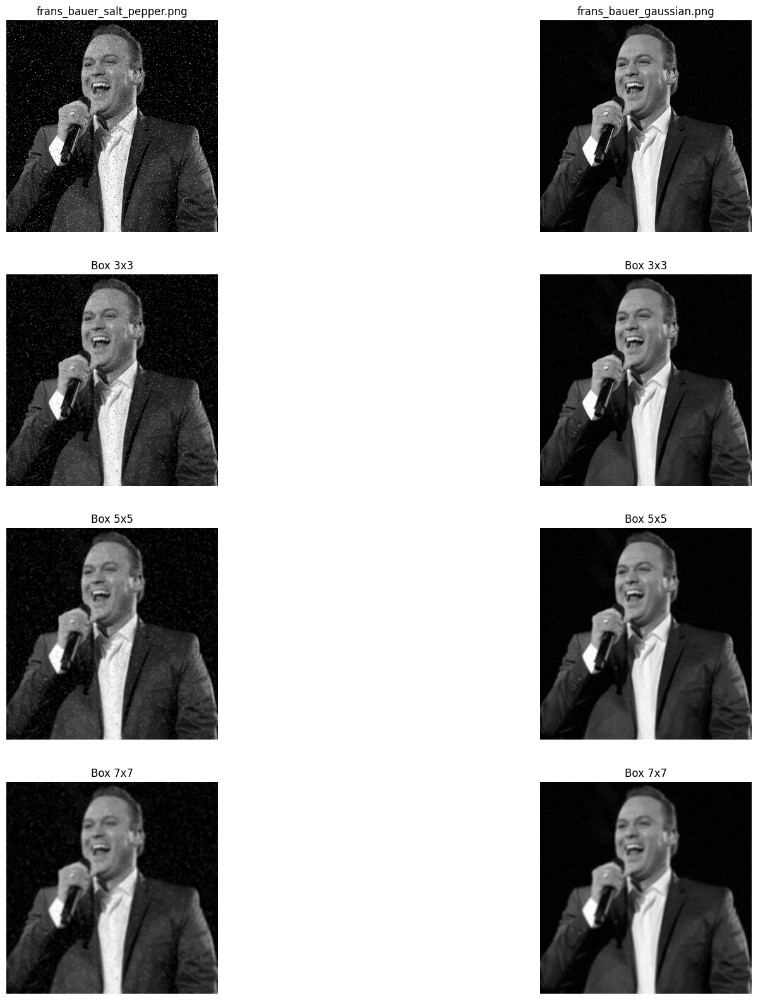

In [20]:
# YOUR CODE HERE
fig, axs = plt.subplots(4, 2, figsize=(20,20))
axs[0,0].imshow(image_2, cmap='gray')
axs[0,0].set_title('frans_bauer_salt_pepper.png')
axs[0,0].axis('off')
axs[0,1].imshow(image_3)
axs[0,1].set_title('frans_bauer_gaussian.png')
axs[0,1].axis('off')
image_2_denoise_box3 = denoise_image(image_2, 'box', kernel_size=3, sigma=1)
image_3_denoise_box3 = denoise_image(image_3, 'box', kernel_size=3, sigma=1)
axs[1,0].imshow(image_2_denoise_box3)
axs[1,0].set_title('Box 3x3')
axs[1,0].axis('off')
axs[1,1].imshow(image_3_denoise_box3)
axs[1,1].set_title('Box 3x3')
axs[1,1].axis('off')
image_2_denoise_box5 = denoise_image(image_2, 'box', kernel_size=5, sigma=1)
image_3_denoise_box5 = denoise_image(image_3, 'box', kernel_size=5, sigma=1)
axs[2,0].imshow(image_2_denoise_box5)
axs[2,0].set_title('Box 5x5')
axs[2,0].axis('off')
axs[2,1].imshow(image_3_denoise_box5)
axs[2,1].set_title('Box 5x5')
axs[2,1].axis('off')
image_2_denoise_box7 = denoise_image(image_2, 'box', kernel_size=7, sigma=1)
image_3_denoise_box7 = denoise_image(image_3, 'box', kernel_size=7, sigma=1)
axs[3,0].imshow(image_2_denoise_box7)
axs[3,0].set_title('Box 7x7')
axs[3,0].axis('off')
axs[3,1].imshow(image_3_denoise_box7)
axs[3,1].set_title('Box 7x7')
axs[3,1].axis('off')

<a id="question-20"></a>
#### <font color='#FF0000'>Question 20 (2 points)</font>

Using your implemented function **denoise_image()**, denoise the `frans_bauer_salt_pepper.png` and `frans_bauer_gaussian.png` images by applying median filtering with kernel sizes of 3x3, 5x5, and 7x7. Display the resulting denoised images.

(-0.5, 511.5, 511.5, -0.5)

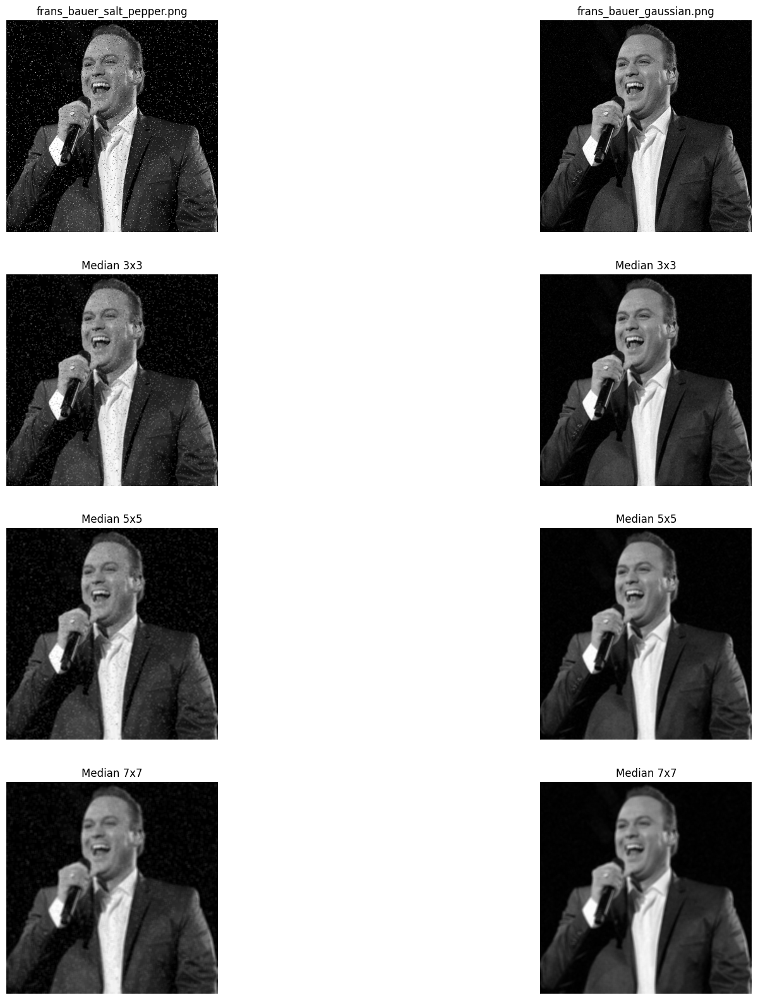

In [21]:
# YOUR CODE HERE
fig, axs = plt.subplots(4, 2, figsize=(20,20))
axs[0,0].imshow(image_2)
axs[0,0].set_title('frans_bauer_salt_pepper.png')
axs[0,0].axis('off')
axs[0,1].imshow(image_3)
axs[0,1].set_title('frans_bauer_gaussian.png')
axs[0,1].axis('off')
image_2_denoise_median3 = denoise_image(image_2, 'median', kernel_size=3, sigma=1)
image_3_denoise_median3 = denoise_image(image_3, 'median', kernel_size=3, sigma=1)
axs[1,0].imshow(image_2_denoise_box3)
axs[1,0].set_title('Median 3x3')
axs[1,0].axis('off')
axs[1,1].imshow(image_3_denoise_box3)
axs[1,1].set_title('Median 3x3')
axs[1,1].axis('off')
image_2_denoise_median5 = denoise_image(image_2, 'median', kernel_size=5, sigma=1)
image_3_denoise_median5 = denoise_image(image_3, 'median', kernel_size=5, sigma=1)
axs[2,0].imshow(image_2_denoise_box5)
axs[2,0].set_title('Median 5x5')
axs[2,0].axis('off')
axs[2,1].imshow(image_3_denoise_box5)
axs[2,1].set_title('Median 5x5')
axs[2,1].axis('off')
image_2_denoise_median7 = denoise_image(image_2, 'median', kernel_size=7, sigma=1)
image_3_denoise_median7 = denoise_image(image_3, 'median', kernel_size=7, sigma=1)
axs[3,0].imshow(image_2_denoise_box7)
axs[3,0].set_title('Median 7x7')
axs[3,0].axis('off')
axs[3,1].imshow(image_3_denoise_box7)
axs[3,1].set_title('Median 7x7')
axs[3,1].axis('off')

<a id="question-21"></a>
#### <font color='#FF0000'>Question 21 (3 points)</font>

Using your implemented function **my_psnr()**, compute the PSNR for each of the 12 denoised images (from Questions 19 and 20) with respect to the original `frans_bauer.png` image. Present your results in a clear and readable format **and** discuss the effect of the filter size on the PSNR. 

**Hint:** Ensure that the images are loaded as `float32` before computation.

In [22]:
# YOUR CODE HERE
print('frans_bauer_salt_pepper box 3x3:', calculate_psnr(image_1, image_2_denoise_box3))
print('frans_bauer_salt_pepper box 5x5:', calculate_psnr(image_1, image_2_denoise_box5))
print('frans_bauer_salt_pepper box 7x7:', calculate_psnr(image_1, image_2_denoise_box7))
print('--------------------------------------------------------------------------------')
print('frans_bauer_gaussian box 3x3:', calculate_psnr(image_1, image_3_denoise_box3))
print('frans_bauer_gaussian box 5x5:', calculate_psnr(image_1, image_3_denoise_box5))
print('frans_bauer_gaussian box 7x7:', calculate_psnr(image_1, image_3_denoise_box7))
print('--------------------------------------------------------------------------------')
print('frans_bauer_salt_pepper median 3x3:', calculate_psnr(image_1, image_2_denoise_median3))
print('frans_bauer_salt_pepper median 5x5:', calculate_psnr(image_1, image_2_denoise_median5))
print('frans_bauer_salt_pepper median 7x7:', calculate_psnr(image_1, image_2_denoise_median7))
print('--------------------------------------------------------------------------------')
print('frans_bauer_gaussian median 3x3:', calculate_psnr(image_1, image_3_denoise_median3))
print('frans_bauer_gaussian median 5x5:', calculate_psnr(image_1, image_3_denoise_median5))
print('frans_bauer_gaussian median 7x7:', calculate_psnr(image_1, image_3_denoise_median7))

frans_bauer_salt_pepper box 3x3: 25.791773796081543
frans_bauer_salt_pepper box 5x5: 26.408684253692627
frans_bauer_salt_pepper box 7x7: 25.776405334472656
--------------------------------------------------------------------------------
frans_bauer_gaussian box 3x3: 30.896494388580322
frans_bauer_gaussian box 5x5: 28.33085536956787
frans_bauer_gaussian box 7x7: 26.80027484893799
--------------------------------------------------------------------------------
frans_bauer_salt_pepper median 3x3: 34.83184814453125
frans_bauer_salt_pepper median 5x5: 31.340765953063965
frans_bauer_salt_pepper median 7x7: 29.715800285339355
--------------------------------------------------------------------------------
frans_bauer_gaussian median 3x3: 34.33708667755127
frans_bauer_gaussian median 5x5: 31.26655340194702
frans_bauer_gaussian median 7x7: 29.658629894256592


##### <font color='yellow'>Answer:</font>

For most of the sets of images, increasing the size of the kernel will decrease the PSNR. This is likely because the blur gets too much, which makes it look less like the original image. An exception to this are the salt_pepper images using a box blur, here the 5x5 filter achieves the highest score. These results also shows that the median blur achieves a higher score than the box blur, for both salt_pepper noise and gaussian noise.

<a id="question-22"></a>
#### <font color='#FF0000'>Question 22 (2 points)</font>

Which filter is more effective for removing salt-and-pepper noise, box or median filters? Explain your reasoning. Also, consider which filter performs better for Gaussian noise and why.

##### <font color='yellow'>Answer:</font>

The median filter is more effective for removing salt-and-pepper noise, since this filter achieves a higher PSNR value in comparison to the box filter. The median filter also performs better for the gaussian noise, as it also achieves a higher PSNR value than the box filter.

<a id="question-23"></a>
#### <font color='#FF0000'>Question 23 (2 points)</font>

Using your implemented function **denoise_image()**, denoise the `frans_bauer_gaussian.png` image by applying Gaussian filtering with kernel sizes of 3x3, 5x5, and 7x7, and standard deviations of 0.5, 1, 3, and 7.

Display the resulting denoised images.

(-0.5, 511.5, 511.5, -0.5)

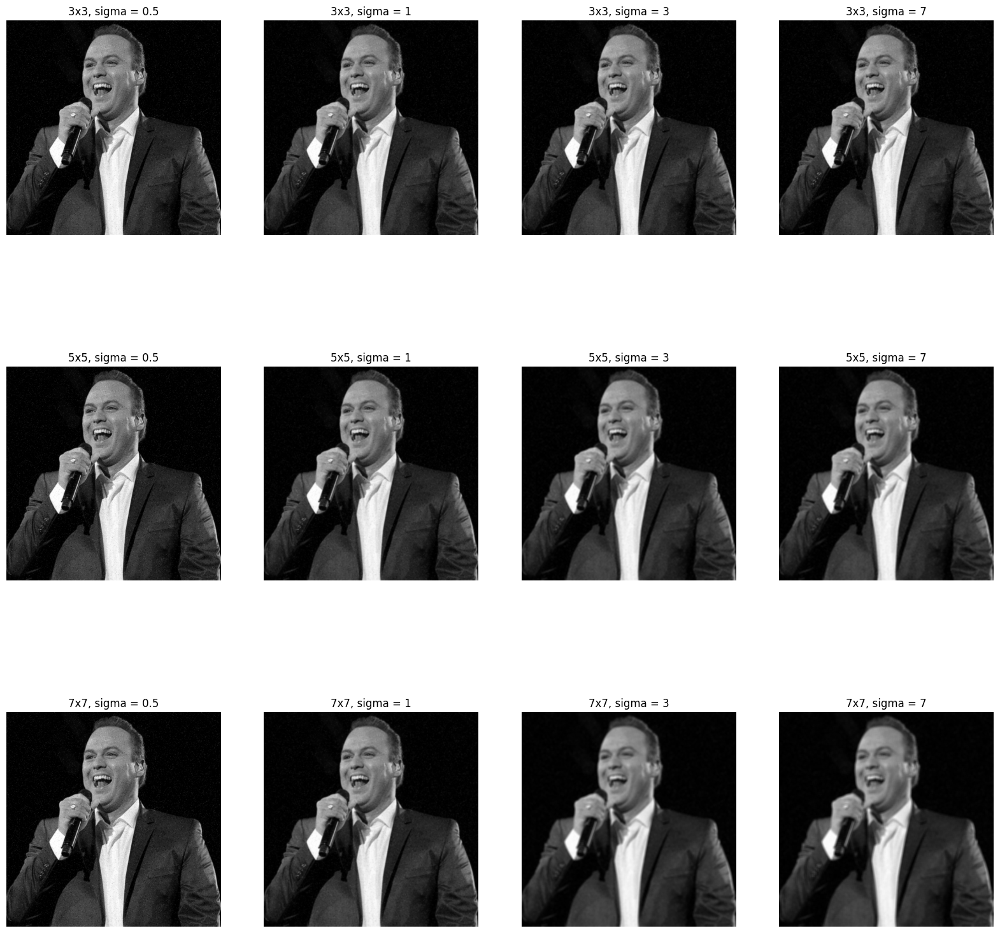

In [23]:
# YOUR CODE HERE
fig, axs = plt.subplots(3, 4, figsize=(20,20))
# sigma = 0.5
image_3_denoise_gaussian3 = denoise_image(image_3, 'gaussian', kernel_size=3, sigma=0.5)
axs[0,0].imshow(image_3_denoise_gaussian3)
axs[0,0].set_title('3x3, sigma = 0.5')
axs[0,0].axis('off')
image_3_denoise_gaussian5 = denoise_image(image_3, 'gaussian', kernel_size=5, sigma=0.5)
axs[1,0].imshow(image_3_denoise_gaussian5)
axs[1,0].set_title('5x5, sigma = 0.5')
axs[1,0].axis('off')
image_3_denoise_gaussian7 = denoise_image(image_3, 'gaussian', kernel_size=7, sigma=0.5)
axs[2,0].imshow(image_3_denoise_gaussian7)
axs[2,0].set_title('7x7, sigma = 0.5')
axs[2,0].axis('off')
# sigma = 1
image_3_denoise_gaussian3_2 = denoise_image(image_3, 'gaussian', kernel_size=3, sigma=1)
axs[0,1].imshow(image_3_denoise_gaussian3_2)
axs[0,1].set_title('3x3, sigma = 1')
axs[0,1].axis('off')
image_3_denoise_gaussian5_2 = denoise_image(image_3, 'gaussian', kernel_size=5, sigma=1)
axs[1,1].imshow(image_3_denoise_gaussian5_2)
axs[1,1].set_title('5x5, sigma = 1')
axs[1,1].axis('off')
image_3_denoise_gaussian7_2 = denoise_image(image_3, 'gaussian', kernel_size=7, sigma=1)
axs[2,1].imshow(image_3_denoise_gaussian7_2)
axs[2,1].set_title('7x7, sigma = 1')
axs[2,1].axis('off')
# sigma = 3
image_3_denoise_gaussian3_3 = denoise_image(image_3, 'gaussian', kernel_size=3, sigma=3)
axs[0,2].imshow(image_3_denoise_gaussian3_3)
axs[0,2].set_title('3x3, sigma = 3')
axs[0,2].axis('off')
image_3_denoise_gaussian5_3 = denoise_image(image_3, 'gaussian', kernel_size=5, sigma=3)
axs[1,2].imshow(image_3_denoise_gaussian5_3)
axs[1,2].set_title('5x5, sigma = 3')
axs[1,2].axis('off')
image_3_denoise_gaussian7_3 = denoise_image(image_3, 'gaussian', kernel_size=7, sigma=3)
axs[2,2].imshow(image_3_denoise_gaussian7_3)
axs[2,2].set_title('7x7, sigma = 3')
axs[2,2].axis('off')
# sigma = 7
image_3_denoise_gaussian3_4 = denoise_image(image_3, 'gaussian', kernel_size=3, sigma=7)
axs[0,3].imshow(image_3_denoise_gaussian3_4)
axs[0,3].set_title('3x3, sigma = 7')
axs[0,3].axis('off')
image_3_denoise_gaussian5_4 = denoise_image(image_3, 'gaussian', kernel_size=5, sigma=7)
axs[1,3].imshow(image_3_denoise_gaussian5_4)
axs[1,3].set_title('5x5, sigma = 7')
axs[1,3].axis('off')
image_3_denoise_gaussian7_4 = denoise_image(image_3, 'gaussian', kernel_size=7, sigma=7)
axs[2,3].imshow(image_3_denoise_gaussian7_4)
axs[2,3].set_title('7x7, sigma = 7')
axs[2,3].axis('off')

<a id="question-24"></a>
#### <font color='#FF0000'>Question 24 (3 points)</font>

Present your results for the PSNR scores of the 12 images from Question 22 in a clear and readable format **and** discuss the effect of the standard deviation on the PSNR.

In [24]:
# YOUR CODE HERE
print('frans_bauer_gaussian 3x3, sigma = 0.5:', calculate_psnr(image_1, image_3_denoise_gaussian3))
print('frans_bauer_gaussian 5x5, sigma = 0.5:', calculate_psnr(image_1, image_3_denoise_gaussian5))
print('frans_bauer_gaussian 7x7, sigma = 0.5', calculate_psnr(image_1, image_3_denoise_gaussian7))
print('--------------------------------------------------------------------------------')
print('frans_bauer_gaussian 3x3, sigma = 1', calculate_psnr(image_1, image_3_denoise_gaussian3_2))
print('frans_bauer_gaussian 5x5, sigma = 1', calculate_psnr(image_1, image_3_denoise_gaussian5_2))
print('frans_bauer_gaussian 7x7, sigma = 1', calculate_psnr(image_1, image_3_denoise_gaussian7_2))
print('--------------------------------------------------------------------------------')
print('frans_bauer_gaussian 3x3, sigma = 3', calculate_psnr(image_1, image_3_denoise_gaussian3_3))
print('frans_bauer_gaussian 5x5, sigma = 3', calculate_psnr(image_1, image_3_denoise_gaussian5_3))
print('frans_bauer_gaussian 7x7, sigma = 3', calculate_psnr(image_1, image_3_denoise_gaussian7_3))
print('--------------------------------------------------------------------------------')
print('frans_bauer_gaussian 3x3, sigma = 7', calculate_psnr(image_1, image_3_denoise_gaussian3_4))
print('frans_bauer_gaussian 5x5, sigma = 7', calculate_psnr(image_1, image_3_denoise_gaussian5_4))
print('frans_bauer_gaussian 7x7, sigma = 7', calculate_psnr(image_1, image_3_denoise_gaussian7_4))

frans_bauer_gaussian 3x3, sigma = 0.5: 30.935869216918945
frans_bauer_gaussian 5x5, sigma = 0.5: 30.935869216918945
frans_bauer_gaussian 7x7, sigma = 0.5 30.935869216918945
--------------------------------------------------------------------------------
frans_bauer_gaussian 3x3, sigma = 1 31.70381784439087
frans_bauer_gaussian 5x5, sigma = 1 31.071648597717285
frans_bauer_gaussian 7x7, sigma = 1 30.9840726852417
--------------------------------------------------------------------------------
frans_bauer_gaussian 3x3, sigma = 3 30.97301483154297
frans_bauer_gaussian 5x5, sigma = 3 28.63872766494751
frans_bauer_gaussian 7x7, sigma = 3 27.437283992767334
--------------------------------------------------------------------------------
frans_bauer_gaussian 3x3, sigma = 7 30.91341495513916
frans_bauer_gaussian 5x5, sigma = 7 28.395299911499023
frans_bauer_gaussian 7x7, sigma = 7 26.922156810760498


##### <font color='yellow'>Answer:</font>

The results show that the standard deviation does have an effect on the PSNR value. Increasing the sigma, and thus the standard deviation, first increases the PSNR value. However, at a certain point (sigma = 3), the PSNR value drops again. This might be because the image has become too blurry, meaning it starts looking less like the original image.

<a id="question-25"></a>
#### <font color='#FF0000'>Question 25 (2 points)</font>

What is the difference among median filtering, box filtering, and Gaussian filtering? Briefly explain how they are different at a conceptual level. If two filtering methods give similar PSNR values, can you see a qualitative difference?

##### <font color='yellow'>Answer:</font>

All three filters replace the each pixel's value based on its neighbours. The box filter takes the average of the pixel's neighbours, the median filter takes the median of the pixel's neighbours and the gaussian filter takes the weighted average of the pixel's neighbours. If two filtering methods give similar PSNR values, you can see a qualitative difference. Since the gaussian filter is weighted, it produces a less blurry image where details are more maintained when compared to the box filter. In addition, the median filter might produce slightly incorrect pixels if the median of the neighbouring pixels does not fit in the overall image.

<a id="section-5"></a>
### **Section 5: Edge Detection**

Edges in digital images represent areas where there is a significant change in brightness, often corresponding to the boundaries of objects. Detecting these edges is a crucial task in many computer vision applications, such as autonomous driving, where edge detection can be used to identify road boundaries and determine the vehicle's trajectory.

In this section, we will explore various techniques for edge detection, focusing specifically on filters that extract the gradient of the image. The gradient represents the rate of change in brightness and is calculated using first-order derivative filters. The Sobel operator, one of the most common methods, approximates the first derivative of a Gaussian filter and is used to detect edges by highlighting the intensity gradients in an image.

The Sobel operator uses two 3x3 convolution kernels, one for detecting changes in the horizontal direction (G_x) and the other for the vertical direction (G_y). The kernels are defined as follows:

$G_x = \begin{bmatrix} +1 & 0 & -1 \\ +2 & 0 & -2 \\ +1 & 0 & -1 \end{bmatrix} * \mathbf{I}$

$G_y = \begin{bmatrix} +1 & +2 & +1 \\ 0 & 0 & 0 \\ -1 & -2 & -1 \end{bmatrix} * \mathbf{I}$

The gradient magnitude, which combines the horizontal and vertical gradients, is given by:

$G =\sqrt {{G_x}^2+{G_y}^2}$

The direction of the gradient, indicating the orientation of the edge, is calculated as:

$\theta= \tan^{-1}\left(\frac{G_y}{G_x}\right)$

These calculations allow us to detect and quantify edges in an image. In this section, we will apply these methods to extract edges from images, with a particular focus on detecting roads in still images, which is a critical task in autonomous driving systems.

<a id="question-26"></a>
#### <font color='#FF0000'>Question 26 (4 points)</font>

Implement the function **compute_image_gradient()** to compute the gradients of an image. This function should calculate the gradients in both the x and y directions, as well as the gradient magnitude and direction.

You are not allowed to use Python built-in functions for computing gradients, but you may use the `scipy.signal.convolve2d` function for performing 2D convolution.

Additionally, complete the helper function **normalize_image()** to normalize the gradients.

In [25]:
def normalize_image(image: np.ndarray, low=0, high=1) -> np.ndarray:
    '''
    Normalizes the input image to a specified range [low, high].

    Args:
        image: The input image as a numpy array.
        low: The lower bound of the normalization range (default is 0).
        high: The upper bound of the normalization range (default is 1).

    Returns:
        normalized_image: The normalized image as a numpy array.
    '''

    # Convert the image to float32 for precision during normalization
    image = image.astype(np.float32)
    
    # YOUR CODE HERE
    min_val = np.min(image)
    max_val = np.max(image)
    
    normalized_image = (image - min_val) / (max_val - min_val + 1e-9)
    normalized_image = low + normalized_image * (high - low)
    
    
    return normalized_image

In [26]:
def compute_image_gradient(input_image: np.ndarray):
    '''
    Computes the gradients of the input image in both x and y directions,
    along with the gradient magnitude and direction.

    Args:
        input_image: The input image as a 2D numpy array.

    Returns:
        gradient_x: The gradient of the image in the x direction.
        gradient_y: The gradient of the image in the y direction.
        gradient_magnitude: The magnitude of the gradient.
        gradient_direction: The direction of the gradient (in degrees).
    '''

    # Sobel kernels for x and y directions
    sobel_x = [[1, 0, -1],
               [2, 0, -2],
               [1, 0, -1]]

    sobel_y = [[1, 2, 1],
               [0, 0, 0],
               [-1, -2, -1]]

    # YOUR CODE HERE
    gradient_x = scipy.signal.convolve2d(input_image, sobel_x)#*np.eye(3,3))
    gradient_y = scipy.signal.convolve2d(input_image, sobel_y)#*np.eye(3,3))
    gradient_magnitude = np.sqrt(np.power(gradient_x, 2) + np.power(gradient_y, 2))

    gradient_x = normalize_image(gradient_x)
    gradient_y = normalize_image(gradient_y)
    
    gradient_direction = np.arctan2(gradient_y, gradient_x)
    

    return gradient_x, gradient_y, gradient_magnitude, gradient_direction

<a id="question-27"></a>
#### <font color='#FF0000'>Question 27 (3 points)</font>

Using your implemented function **compute_image_gradient()** on `landscape.jpg`, display the following figures:

1. The gradient of the image in the x-direction.
2. The gradient of the image in the y-direction.
3. The gradient magnitude of each pixel.
4. The gradient direction of each pixel.

Discuss what kind of information each image conveys.

In [27]:
sobel_x = [[1, 0, -1],
           [2, 0, -2],
           [1, 0, -1]]

sobel_x * np.eye(3,3)

array([[ 1.,  0., -0.],
       [ 0.,  0., -0.],
       [ 0.,  0., -1.]])

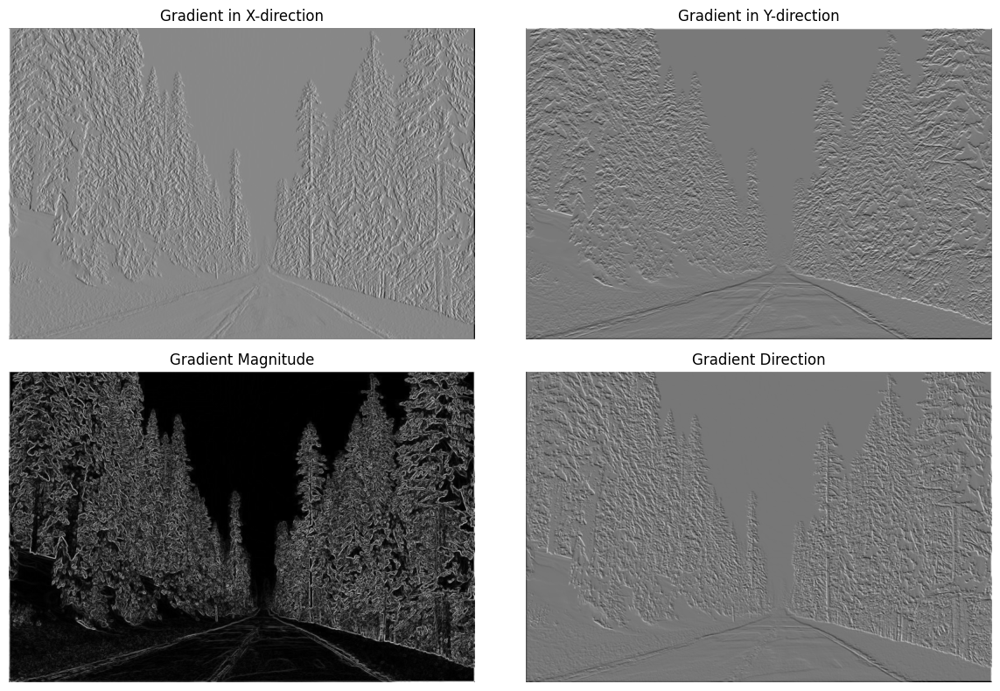

In [28]:
image1 = cv2.imread("images/landscape.jpg", cv2.IMREAD_GRAYSCALE)
grad_x, grad_y, grad_magnitude, grad_direction = compute_image_gradient(image1)
plt.figure(figsize=(12, 8))

# Gradient x
plt.subplot(2, 2, 1)
plt.title('Gradient in X-direction')
plt.axis('off')
plt.imshow(grad_x, cmap='gray')
# Gradient y
plt.subplot(2, 2, 2)
plt.title('Gradient in Y-direction')
plt.axis('off')
plt.imshow(grad_y, cmap='gray')

# Magnitude
plt.subplot(2, 2, 3)
plt.title('Gradient Magnitude')
plt.axis('off')
plt.imshow(grad_magnitude, cmap='gray')

# Arctan
plt.subplot(2, 2, 4)
plt.title('Gradient Direction')
plt.axis('off')
plt.imshow(grad_direction, cmap='gray')

plt.tight_layout()
plt.show()


##### <font color='yellow'>Answer:</font>

The gradient in X-direction plot, highlights edges and transitions along the horizontal axis. It emphasizes mostly on sharper changes along it.

The Y-gradient emphasizes changes in the vertical direction. For example, the tops of the trees and the sky are more important for this gradient, in comparison to the road or the horizon.

The gradient magnitude combines both X and Y gradients, showing the overall intensity of edges regardless of direction. The brightest parts of this plot indicate strong edges, and it highlights detailed features like the tree lines and the road edges.

Finally, the gradient direction depicts the angle of the edges in the image. It represents the direction of the change in intensity, which can helps to identify the orientation of the objects. The direction is less apparent in comparison to magnitude but helps in understanding the overall layout of features.

<a id="question-28"></a>
#### <font color='#FF0000'>Question 28 (4 points)</font>

Compared to the Sobel filter, a Laplacian of Gaussian (LoG) relies on the second derivative of a Gaussian filter. Hence, it will focus on large gradients in the image.

Implement the function **compute_laplacian_of_gaussian()** to compute the Laplacian of Gaussian (LoG) for an image using each the following methods:

1. Smoothing the image with a Gaussian kernel, then applying the Laplacian (second derivative) to the smoothed image.
2. Convolving the image directly with a LoG kernel.
3. Computing the Difference of Gaussians (DoG) at different scales $\sigma_1$ and $\sigma_2$.

The function should take arguments *method*, *kernel_size*, *sigma*, *sigma_1*, and *sigma_2* to specify the parameters for each method.

**Note:** You are not allowed to use Python built-in functions for computing LoG kernels, but you can use `scipy.signal.convolve2d` for 2D convolution.

In [29]:
def compute_laplacian_of_gaussian(image, method, kernel_size=5, sigma=0.5, sigma_1=0.5, sigma_2=1.0):
    '''
    Computes the Laplacian of Gaussian (LoG) using the specified method.

    Args:
        image: Input image as a 2D numpy array.
        method: Specifies which method to use (1, 2, or 3).
        kernel_size: Size of the Gaussian kernel (default is 5).
        sigma: Standard deviation of the Gaussian for methods 1 and 2 (default is 0.5).
        sigma_1: Standard deviation of the first Gaussian for method 3 (default is 0.5).
        sigma_2: Standard deviation of the second Gaussian for method 3 (default is 1.0).

    Returns:
        log_image: The resulting image after applying the Laplacian of Gaussian.
    '''

    # Define the Laplacian kernel for the second derivative
    laplacian_kernel = np.array([[0, -1, 0],
                                 [-1, 4, -1],
                                 [0, -1, 0]])

    if method == 1:
        # Method 1: Gaussian smoothing followed by the Laplacian

        # YOUR CODE HERE
        gaussian = gaussian_kernel_2D(sigma, sigma,  kernel_size)
        smoothed_image = scipy.signal.convolve2d(image, gaussian)
        log_image = scipy.signal.convolve2d(smoothed_image, laplacian_kernel, mode = "same", boundary = "symm")


    elif method == 2:
        # Method 2: Direct convolution with a LoG kernel

        # YOUR CODE HERE
        log_image = scipy.signal.convolve2d(image, laplacian_kernel, mode = "same", boundary = "symm")


    elif method == 3:
        # Method 3: Difference of Gaussians (DoG)

        # YOUR CODE HERE
        gaussian1 = gaussian_kernel_2D(sigma_1, sigma_1, kernel_size)
        gaussian2 = gaussian_kernel_2D(sigma_2, sigma_2, kernel_size)
        smoothed_image1 = scipy.signal.convolve2d(image, gaussian1, mode = "same", boundary = "symm")
        smoothed_image2 = scipy.signal.convolve2d(image, gaussian2, mode = "same", boundary = "symm")
        log_image = smoothed_image1 - smoothed_image2

    else:
        raise ValueError("Invalid method. Choose 1, 2, or 3.")

    return log_image

<a id="question-29"></a>
#### <font color='#FF0000'>Question 29 (1 point)</font>

Test your **compute_laplacian_of_gaussian()** function using `landscape.jpg` and visualize your results using the three methods. Use the default parameters provided for each method.

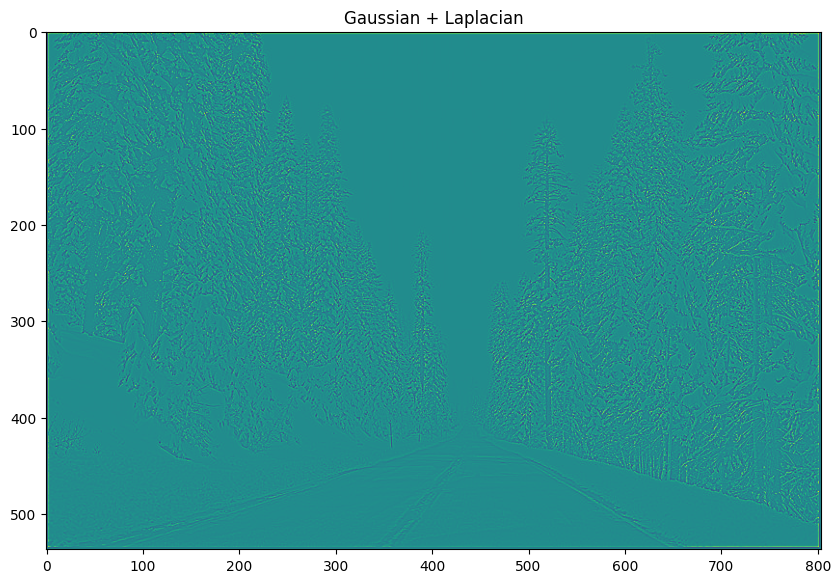

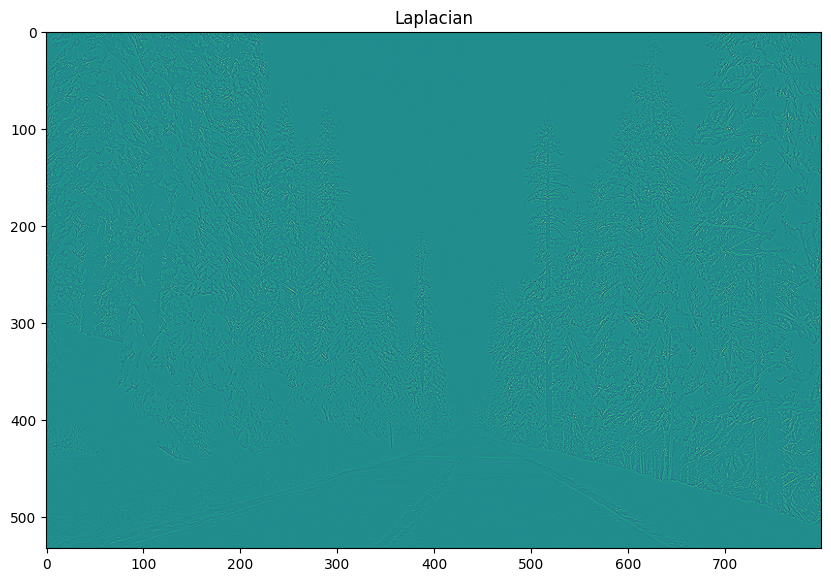

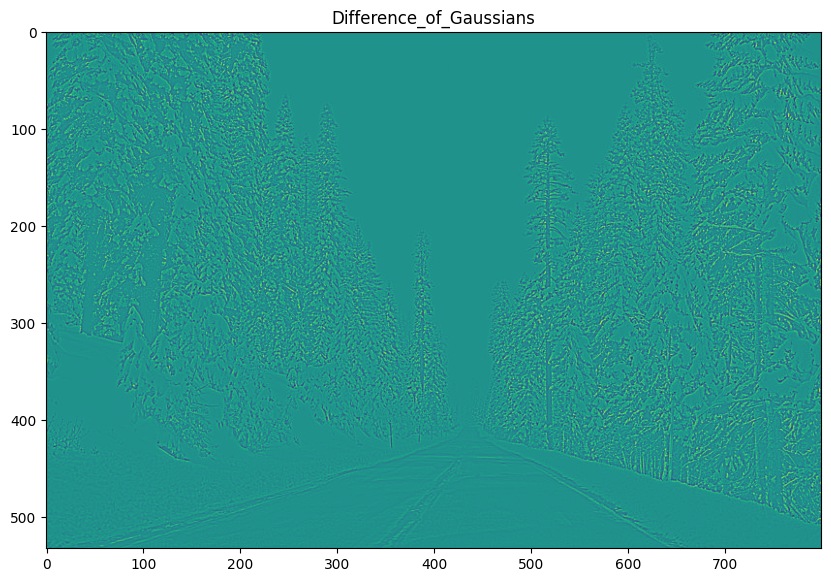

In [30]:
image1 = cv2.imread("images/landscape.jpg", cv2.IMREAD_GRAYSCALE)

for method in range(1, 4):
    log_image = compute_laplacian_of_gaussian(image1, method)

    plt.figure(figsize=(10, 10))
    if method == 1:
        plt.title("Gaussian + Laplacian")
    elif method == 2:
        plt.title("Laplacian")
    else:
        plt.title("Difference_of_Gaussians")
    plt.imshow(log_image)
    
    # Display the plot
    plt.show()

<a id="question-30"></a>
#### <font color='#FF0000'>Question 30 (2 points)</font>

Discuss the differences between applying the three methods of the Laplacian of Gaussian (LoG) on `landscape.jpg`. Consider how each method approaches edge detection and the visual results produced by each technique.

##### <font color='yellow'>Answer:</font>

Method 2 (Lacplacian) shows the least amount of edge detection. This is likely due to the increased amount of noise that this method uses. This makes it less able to detect meaningful edges. Furthermore, Method 1 (Gaussian + Lacplacian) first smooths the image which decreases the amount of noise. This is likely why it gives a better edge detection result than Method 2 (Laplacian). Last, Method 3 shows the best edge detection results. Here the edges are clearly defined, and it shows both small and large edges.

<a id="question-31"></a>
#### <font color='#FF0000'>Question 31 (2 points)</font>

In the first method, why is it important to convolve an image with a Gaussian before convolving with a Laplacian?

##### <font color='yellow'>Answer:</font>

This is important to achieve noise reduction. The Laplacian alone is very susceptible to noise, as noise can cause quick gradient changes and Laplacian puts into effect the second derivative. This noise can thus lead to false or overly detected edges. When first applying the Gaussian filter, which smooths the image, this noise is decreased from the image allowing the Laplacian to find the more meaningful edges.

<a id="question-32"></a>
#### <font color='#FF0000'>Question 32 (2 points)</font>

In the third method, what is the best ratio between $\sigma_1$ and $\sigma_2$ to achieve the best approximation of the LoG? What is the purpose of having two different standard deviations?

**Hint**: The best approximation for our case is found when both $\sigma_1$ and $\sigma_2$ are within the range of 1 to 10.

In [31]:
sigma1 = np.linspace(1, 10, 20)
sigma2 = np.linspace(1, 10, 20)
best_psnr = 0
best_sigmas = (0, 0)

log_image1 = compute_laplacian_of_gaussian(image1, method=2)

for i in sigma1:
    for j in sigma2:
        log_image2 = compute_laplacian_of_gaussian(image1, method=3, sigma_1=i, sigma_2=j)
        
        psnr_new = calculate_psnr(normalize_image(log_image1+128), normalize_image(log_image2+128))
        
        if psnr_new > best_psnr:
            best_psnr = psnr_new
            best_sigmas = (i, j)

print("The ratio is: ", best_sigmas[1]/best_sigmas[0])
print(f"The best PSNR is: {best_psnr}")
print(f"The sigmas used were: sigma_1 = {best_sigmas[0]}, sigma_2 = {best_sigmas[1]}")


The ratio is:  1.4736842105263157
The best PSNR is: 21.85194730758667
The sigmas used were: sigma_1 = 1.0, sigma_2 = 1.4736842105263157


##### <font color='yellow'>Answer:</font>

The usage of two different sigma values and their ratio are important because they approximate the second derivative of the Gaussian function. By using them for two distinct Gaussians with different levels of smoothing, we get a better capture of the image and specifically for the areas with rapid pixel shifts.

<a id="question-33"></a>
#### <font color='#FF0000'>Question 33 (2 points)</font>

What else is needed to improve the performance and isolate the road? You don't have to provide any specific parameter or algorithm. Propose a direction that would be interesting to explore and explain how you would approach it.

##### <font color='yellow'>Answer:</font>

The best method of the ones we implemented was DoG so the obvious direction is to use this method and try to tune it as best as possible. The only hyperparameter that this method has are the sigma values, therefore we would try to find the optimal ratio. A usual ratio that is used throughout DoG implementations from practitioners is ~1.6, which is close to what we ended up with but shows that there is a room for improvement.

<a id="section-6"></a>
### **Section 6: Foreground-background separation**

Foreground-background separation is a crucial task in the field of computer vision, enabling applications such as object recognition, scene understanding, and image editing. The objective is to distinguish the main object (foreground) from the surrounding area (background) in an image. This process is essential when the foreground object needs to be isolated for further analysis or processing.

In this section, we will implement a simple unsupervised algorithm that leverages texture variations to segment the foreground object from the background. The assumption is that the foreground object has a distinct combination of textures compared to the background, which can be exploited for separation.

Gabor filters, known for their effectiveness in capturing texture information due to their frequency domain characteristics, will be used to analyze the texture differences within the image. By applying a collection of Gabor filters with varying scales and orientations—referred to as a *filter bank*—we can effectively distinguish between different texture patterns in the image.

In the example below, you can see how this process works. The **left** image shows the original input image. The **middle** image displays the foreground mask, which identifies the pixels that belong to the foreground object. The **right** image shows the result of applying the foreground mask to the input image, effectively isolating the foreground object from the background.

<img src="https://drive.google.com/thumbnail?id=1N4hExtMIiMxM03OK4iHKURTvSibccEwd&sz=w1000">

See the outline of the algorithm below:

---

**Foreground-Background Segmentation Algorithm**

---

**Input:** $x$ - input image

**Output:** $y$ - pixelwise labels

1.   Convert to grayscale if necessary.

>**if** $x$ is RGB **then**

>>$x$ $\leftarrow$ rgb2gray($x$)

>**end if**

2.   Create Gabor filterbank, $\mathcal{F}_{gabor}$, with varying $\sigma$, $\lambda$ and $\theta$.

3.   Filter $x$ with the filterbank. Store each output in $fmaps$.

4.   Compute the magnitude of the complex $fmaps$. Store the results in $fmags$.

>$fmags$ $\leftarrow$  $\vert fmaps \vert$

5.   Smooth $fmags$.

>$fmags$ $\leftarrow$  smooth($fmags$)

6.   Convert $fmags$ into data matrix, $f$.

>$f$ $\leftarrow$  reshape($fmags$)

7.   Cluster $f$ using kmeans into two sets.

>$y$ $\leftarrow$  kmeans($f$, 2)

---

<a id="question-33"></a>
#### <font color='#FF0000'>Question 33 (7 points)</font>

Please get familiar with the provided skeleton code below. You will need your implementation of the **create_gabor()** function. When you successfully implement all functions, the code should run without problems and produce a reasonable segmentation with the default parameters on **kobi.png**.

In [32]:
def load_image(image_id="kobi"):
    '''
    Load an image, resize it, and set the correct color representation.

    Args:
        image_id: ID of the image (default is "kobi")

    Returns:
        image: Loaded and processed image
    '''
    if image_id == 'clownfish':
        image = cv2.imread('./images/clownfish.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'flower':
        image = cv2.imread('./images/flower.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'kobi':
        image = cv2.imread('./images/kobi.png')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'landscape':
        image = cv2.imread('./images/landscape.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'polar_bear_hiding':
        image = cv2.imread('./images/polar_bear_hiding.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'robin':
        image = cv2.imread('./images/robin.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'swan':
        image = cv2.imread('./images/swan.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    else:
        raise ValueError('Image not available.')

    return image

In [33]:
def show_image(image, title="Kobi", colormap='gray'):
    '''
    Display an image in grayscale.

    Args:
        image: Image to be displayed
        title: Title for the image (default is "Kobi")
        colormap: Colormap used by matplotlib (default is 'gray')
    '''
    plt.figure()
    plt.title(title)
    plt.imshow(image, cmap=colormap)
    plt.axis("off")

In [34]:
### Foreground-Background Segmentation Algorithm
### Part 0 - Read Image and Convert to Grayscale

def preprocess_image(image_id="kobi"):
    '''
    Load an image, resize it, and convert it to grayscale if necessary.

    Args:
        image_id: ID of the image to load (default is "Kobi")

    Returns:
        grayscale_image: Grayscale image
    '''
    # Load the image
    image = load_image(image_id)
    show_image(image)

    # Check if the image is grayscale or RGB
    if len(image.shape) == 2:
        grayscale_image = image
    else:
        grayscale_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        show_image(grayscale_image, title = "Kobi In Gray")
    return grayscale_image

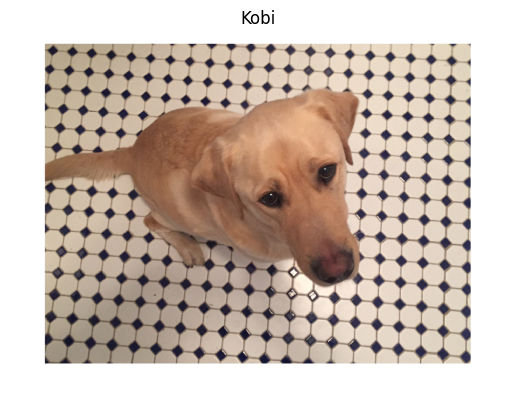

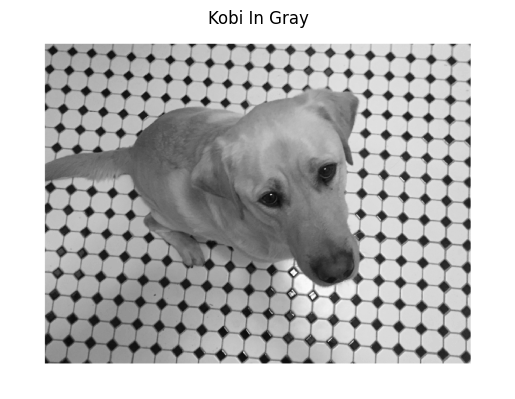

In [35]:
grayscale_image = preprocess_image(image_id="kobi")

In [36]:
def create_gabor_filter_bank(image):
    '''
    Create a Gabor filter bank with varying scales and orientations.

    Args:
        image: Grayscale input image

    Returns:
        gabor_filter_bank: A list of dictionaries containing Gabor filters and their parameters
    '''
    num_rows, num_cols = image.shape

    # Estimate the minimum and maximum wavelengths for the sinusoidal carriers
    lambda_min = 4 / np.sqrt(2)
    lambda_max = np.sqrt(np.abs(num_rows) ** 2 + np.abs(num_cols) ** 2)

    # Specify the carrier wavelengths
    n = np.floor(np.log2(lambda_max / lambda_min))
    lambdas = 2 ** np.arange(0, (n - 2) + 1) * lambda_min

    # Define the set of orientations for the Gaussian envelope (Thetas)
    delta_theta = np.pi / 4.0
    orientations = np.arange(0, np.pi + delta_theta, delta_theta)

    # Define the set of sigmas for the Gaussian envelope (spread of the Gaussian)
    sigmas = np.array([1, 2])

    gabor_filter_bank = []
    start_time = time.time()

    # Total number of features
    n_features = len(lambdas) * len(sigmas) * len(orientations)

    with tqdm(total=n_features) as pbar:

        # Generate Gabor filters for each combination of wavelength, sigma, and orientation
        for wavelength in lambdas:
            for sigma in sigmas:
                for theta in orientations:
                    # Filter parameter configuration
                    psi = 0
                    gamma = 0.5

                    # Create a Gabor filter with the specified parameters
                    filter_config = {}
                    filter_config["filter_pairs"] = create_gabor(sigma, theta, wavelength, psi, gamma)
                    filter_config["sigma"] = sigma
                    filter_config["wavelength"] = wavelength
                    filter_config["theta"] = theta
                    filter_config["psi"] = psi
                    filter_config["gamma"] = gamma

                    # Append the filter configuration to the filter bank
                    gabor_filter_bank.append(filter_config)

                    # Update the progress bar
                    pbar.update(1)

    creation_time = time.time() - start_time
    
    # Print details about the created filter bank
    print(f'Total number of filters: {len(gabor_filter_bank)}')
    print(f'Number of scales (sigma): {len(sigmas)}')
    print(f'Number of orientations (theta): {len(orientations)}')
    print(f'Number of carriers (lambda): {len(lambdas)}')
    print(f'\nFilter bank created in {creation_time} seconds.')

    return gabor_filter_bank

In [37]:
gabor_filter_bank = create_gabor_filter_bank(grayscale_image)

100%|████████████████████████████████████████████████████████████████████████████████| 80/80 [00:00<00:00, 5000.74it/s]

Total number of filters: 80
Number of scales (sigma): 2
Number of orientations (theta): 5
Number of carriers (lambda): 8

Filter bank created in 0.02312946319580078 seconds.


In [38]:
### Foreground-Background segmentation algoritm
### Part 2 - gabor features fMaps and fMags

def extract_gabor_features(image, gabor_filter_bank, visualize=False):
    '''
    Filter images using the Gabor filter bank with quadrature pairs (real and imaginary parts).

    Args:
        image: Grayscale input image
        gabor_filter_bank: A list of dictionaries containing Gabor filters and their parameters
        visualize: Flag to visualize filter responses (default is False)

    Returns:
        feature_magnitudes: List of magnitude responses for each Gabor filter
    '''
    feature_maps = []

    with tqdm(total=len(gabor_filter_bank)) as pbar:

        for gabor_filter in gabor_filter_bank:
            # Filter the image with the real and imaginary parts of the Gabor filter

            real_output = None
            imaginary_output = None

            real_filter = np.real(gabor_filter["filter_pairs"])
            imaginary_filter = np.imag(gabor_filter["filter_pairs"])

            real_output = cv2.filter2D(image, cv2.CV_64F, real_filter)
            imaginary_output = cv2.filter2D(image, cv2.CV_64F, imaginary_filter)

            # Append the real and imaginary parts to the list of feature maps
            feature_maps.append(np.stack((real_output, imaginary_output), 2))

            # Update the progress bar
            pbar.update(1)

            # Visualize the filter responses if requested
            if visualize:
                fig = plt.figure()
                ax = fig.add_subplot(1, 2, 1)
                ax.imshow(real_output, cmap='gray')
                ax.set_title(f'Real Part, λ={gabor_filter["wavelength"]:.4f}, θ={gabor_filter["theta"]:.4f}, σ={gabor_filter["sigma"]:.4f}')
                ax.axis("off")

                ax = fig.add_subplot(1, 2, 2)
                ax.imshow(imaginary_output, cmap='gray')
                ax.set_title(f'Imaginary Part, λ={gabor_filter["wavelength"]:.4f}, θ={gabor_filter["theta"]:.4f}, σ={gabor_filter["sigma"]:.4f}')
                ax.axis("off")
                plt.show()

    # Compute the magnitude of the output responses
    feature_magnitudes = []

    with tqdm(total=len(feature_maps)) as pbar:
    
        for i, feature_map in enumerate(feature_maps):

            # Compute the magnitude of the feature map
            real_output = feature_map[:, :, 0]
            imaginary_output = feature_map[:, :, 1]
            magnitude = np.sqrt(real_output**2 + imaginary_output**2)
            feature_magnitudes.append(magnitude)

            # Update the progress bar
            pbar.update(1)

            # Visualize the magnitude response if requested
            if visualize:
                plt.figure()
                plt.imshow(magnitude.astype(np.uint8), cmap='gray')
                plt.title(f'Magnitude, λ={gabor_filter_bank[i]["wavelength"]:.4f}, θ={gabor_filter_bank[i]["theta"]:.4f}, σ={gabor_filter_bank[i]["sigma"]:.4f}')
                plt.axis("off")
                plt.show()

    print(f'Created {len(feature_magnitudes)} features for each pixel')
    return feature_magnitudes, feature_maps

In [39]:
feature_magnitudes, _ = extract_gabor_features(grayscale_image, gabor_filter_bank)

100%|██████████████████████████████████████████████████████████████████████████████████| 80/80 [00:01<00:00, 45.42it/s]

Created 80 features for each pixel


In [40]:
### Foreground-Background segmentation algoritm
### Part 3 - cluster features in two sets

def cluster_features(image, feature_magnitudes, apply_smoothing=True):
    '''
    Cluster pixels based on their Gabor feature magnitudes.

    Hint: To standardize the features, you can use the following web page: https://www.analyticsvidhya.com/blog/2020/04/feature-scaling-machine-learning-normalization-standardization/

    Args:
        image: Grayscale input image
        feature_magnitudes: List of magnitude responses for each Gabor filter
        apply_smoothing: Flag to apply Gaussian smoothing (default is True)

    Returns:
        pixel_labels: Cluster labels for each pixel
    '''
    num_rows, num_cols = image.shape
    features = np.zeros(shape=(num_rows, num_cols, len(feature_magnitudes)))

    if apply_smoothing:
        # Apply Gaussian smoothing to each feature magnitude
        for i, feature_magnitude in enumerate(feature_magnitudes):
            features[:,:,i] = cv2.GaussianBlur(feature_magnitude, (5,5), 0)

    else:
        # Directly insert magnitude images into the features matrix
        for i, feature_magnitude in enumerate(feature_magnitudes):
            features[:, :, i] = feature_magnitude

    # Reshape the features matrix to prepare for clustering
    features = np.reshape(features, newshape=(num_rows * num_cols, -1))

    # Standardize the features   
    mean = np.mean(features, axis=0)
    std = np.std(features, axis=0)
    standardized_features = (features - mean) / std

    start_time = time.time()

    # Apply k-means clustering
    kmeans = KMeans(n_clusters=2, random_state=0)
    pixel_labels = kmeans.fit_predict(standardized_features)

    print(f'Clustering completed in {time.time() - start_time} seconds.')

    return pixel_labels

In [41]:
pixel_labels = cluster_features(grayscale_image, feature_magnitudes, apply_smoothing=True)

Clustering completed in 4.5534257888793945 seconds.


In [42]:
### Foreground-Background segmentation algorithm
### Part 4 - Visualise result

def visualize_clustering_results(image, pixel_labels):
    '''
    Visualize the clustering results and segmentation.

    Args:
        image: Grayscale input image
        pixel_labels: Cluster labels for each pixel

    Returns:
        None
    '''
    num_rows, num_cols = image.shape
    pixel_labels = np.reshape(pixel_labels, newshape=(num_rows, num_cols))

    # Visualize pixel clusters
    plt.figure()
    plt.title('Pixel Clusters')
    plt.imshow(pixel_labels)
    plt.axis("off")
    plt.show()

    # Use pixel labels to visualize segmentation
    segmented_image1 = np.zeros_like(image)
    segmented_image2 = np.zeros_like(image)

    binary_mask = pixel_labels == 0 # Check for the value of your labels in pixel_labels (could be 1 or 2 instead of 0)

    segmented_image1[binary_mask] = image[binary_mask]
    segmented_image2[~binary_mask] = image[~binary_mask]

    plt.figure()
    plt.title('Montage')
    plt.imshow(segmented_image1, cmap='gray', interpolation='none')
    plt.imshow(segmented_image2, cmap='jet', interpolation='none', alpha=0.7)
    plt.axis("off")
    plt.show()

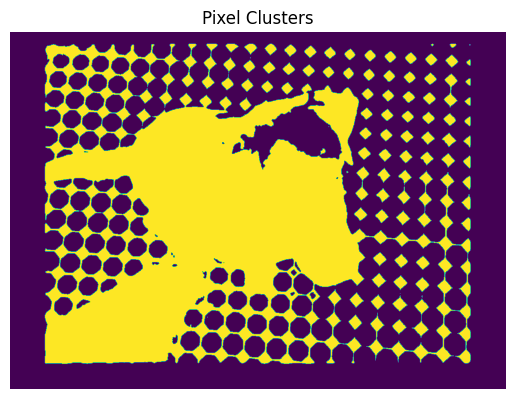

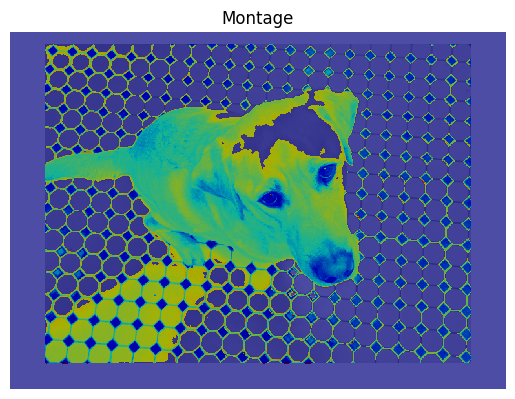

In [43]:
# Visualize the results
visualize_clustering_results(grayscale_image, pixel_labels)

<a id="question-34"></a>
#### <font color='#FF0000'>Question 34 (7 points)</font>

Implement the `foreground_background_separation()` function using Gabor filters. Complete the function provided and experiment with different images (`clownfish`, `flower`, `kobi`, `polar_bear_hiding`, `robin` **and** `swan`) using the default parameters.

Make sure to visualize the results using four subplots: the original image, the pixel representation projected onto the first principal component, the pixel clusters, and the montage showing segmentation. 

After visualizing the results, observe how the `sigmas` and `orientations` parameters influence the foreground-background separation. Describe your observations, focusing on the effectiveness of the separation and any patterns or trends you notice.

In [44]:
def foreground_background_separation(image, sigmas, orientations, apply_smoothing=True):
    '''
    Perform foreground-background segmentation using Gabor filters.

    Args:
        image: Grayscale input image
        sigmas: List of sigmas for the Gaussian envelope
        orientations: List of orientations for the Gabor filters
        apply_smoothing: Flag to apply Gaussian smoothing to magnitude images (default is True)

    Returns:
        None
    '''
    num_rows, num_cols = image.shape

    # Estimate the minimum and maximum wavelengths for the sinusoidal carriers
    lambda_min = 4 / np.sqrt(2)
    lambda_max = np.sqrt(np.abs(num_rows) ** 2 + np.abs(num_cols) ** 2)

    # Specify the carrier wavelengths
    n = np.floor(np.log2(lambda_max / lambda_min))
    lambdas = 2 ** np.arange(0, (n - 2) + 1) * lambda_min

    gabor_filter_bank = []
    start_time = time.time()

    # Total number of features
    n_features = len(lambdas) * len(sigmas) * len(orientations)

    with tqdm(total=n_features) as pbar:

        # Generate Gabor filters for each combination of wavelength, sigma, and orientation
        for wavelength in lambdas:
            for sigma in sigmas:
                for theta in orientations:
                    # Filter parameter configuration
                    psi = 0
                    gamma = 0.5
                    # Create a Gabor filter with the specified parameters
                    filter_config = {}
                    filter_config["filter_pairs"] = create_gabor(sigma, theta, wavelength, psi, gamma)
                    filter_config["sigma"] = sigma
                    filter_config["wavelength"] = wavelength
                    filter_config["theta"] = theta
                    filter_config["psi"] = psi
                    filter_config["gamma"] = gamma

                    # Append the filter configuration to the filter bank
                    gabor_filter_bank.append(filter_config)

    feature_magnitudes, feature_map = extract_gabor_features(image, gabor_filter_bank)
    pixel_labels = cluster_features(image, feature_magnitudes, apply_smoothing)
    num_rows, num_cols = image.shape
    pixel_labels = np.reshape(pixel_labels, newshape=(num_rows, num_cols))

    plt.figure(figsize=(12, 8))
    #Plotting original image
    plt.subplot(2, 2, 1)
    plt.title('Original Image')
    plt.imshow(image, cmap='gray')
    plt.axis("off")
    #PCA projection
    one = np.array(feature_map) #Imaginary part
    one = one[:,:,:,1]
    zero = np.array(feature_map) #Real part
    zero = zero[:,:,:,0]
    one = one.reshape(np.array(feature_map).shape[0],-1)
    zero = zero.reshape(np.array(feature_map).shape[0],-1)
    features = np.vstack((one, zero)).T #Combine the two to get pixel representation
    pca = PCA(n_components=1)
    pca_projection = pca.fit_transform(features) #Transforming pixel representation to PCA 1
    pca_projection = pca_projection.reshape(num_rows, num_cols) #Make sure projection matches original image
    #Plotting PCA projection
    plt.subplot(2, 2, 2)
    plt.title('PCA Projection')
    plt.imshow(pca_projection, cmap='gray')
    plt.axis("off")
    #Plotting pixel clusters
    plt.subplot(2, 2, 3)
    plt.title('Pixel Clusters')
    plt.imshow(pixel_labels, cmap='viridis')
    plt.axis("off")

    segmented_image1 = np.zeros_like(image)
    segmented_image2 = np.zeros_like(image)
    binary_mask = pixel_labels == 0

    segmented_image1[binary_mask] = image[binary_mask]
    segmented_image2[~binary_mask] = image[~binary_mask]
    #Plotting segmented image
    plt.subplot(2, 2, 4)
    plt.title('Montage')
    plt.imshow(segmented_image1, cmap='gray', interpolation='none')
    plt.imshow(segmented_image2, cmap='jet', interpolation='none', alpha=0.7)
    plt.axis("off")

    plt.tight_layout()
    plt.show()
    

100%|█████████████████████████████████████████████████████████████████████████████████| 70/70 [00:00<00:00, 230.74it/s]


Created 70 features for each pixel
Clustering completed in 0.6331520080566406 seconds.


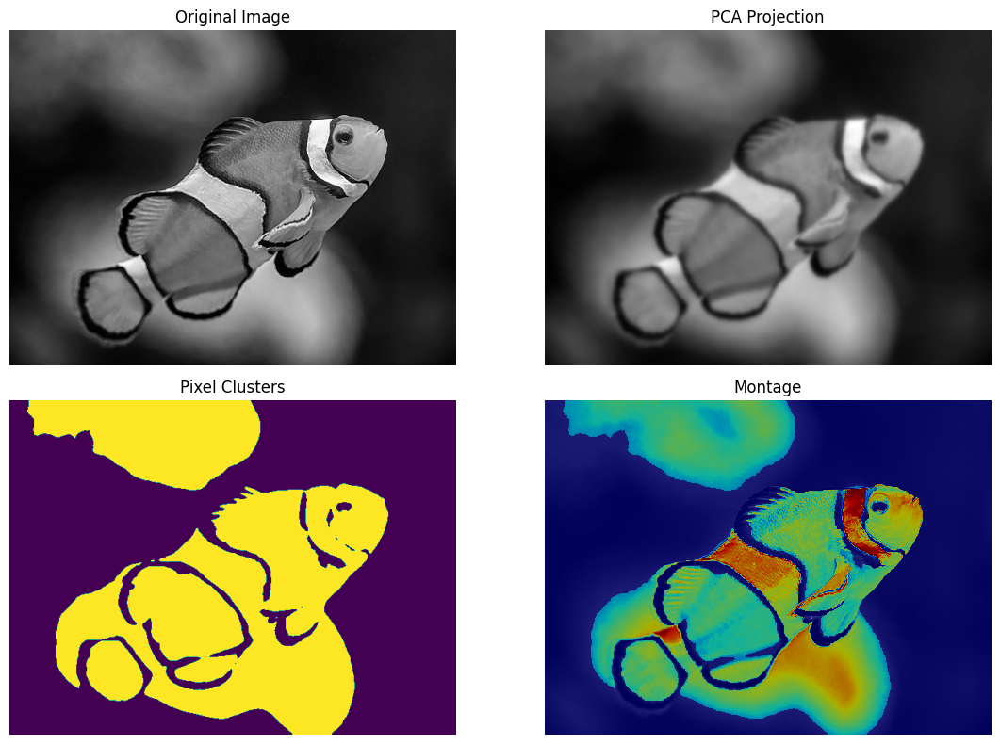

100%|█████████████████████████████████████████████████████████████████████████████████| 70/70 [00:00<00:00, 216.12it/s]


Created 70 features for each pixel
Clustering completed in 0.8967485427856445 seconds.


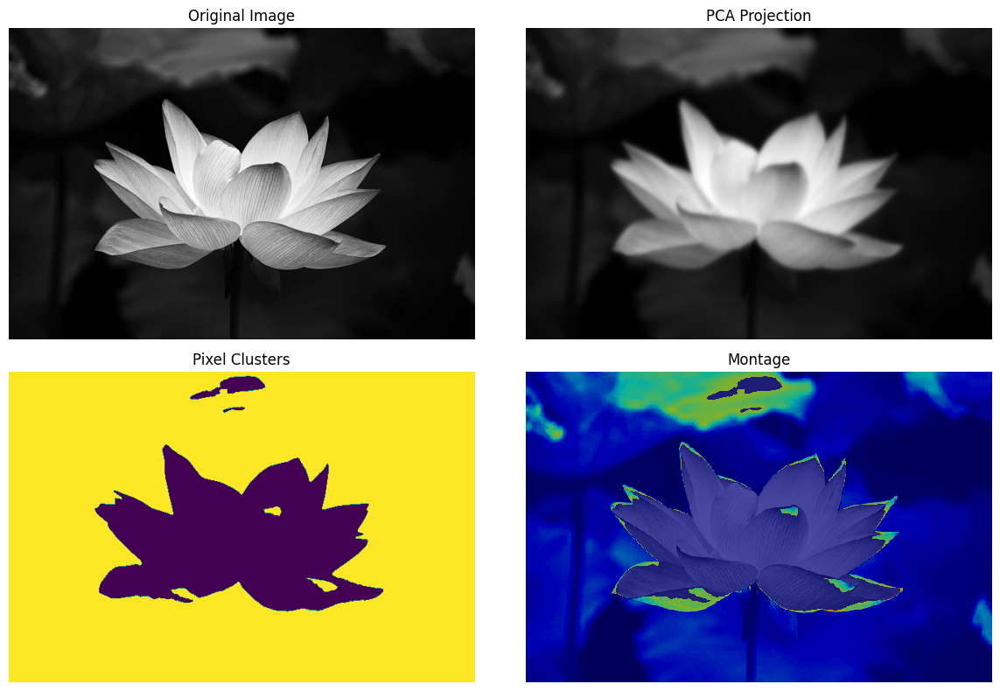

100%|██████████████████████████████████████████████████████████████████████████████████| 80/80 [00:01<00:00, 57.89it/s]


Created 80 features for each pixel
Clustering completed in 6.6766862869262695 seconds.


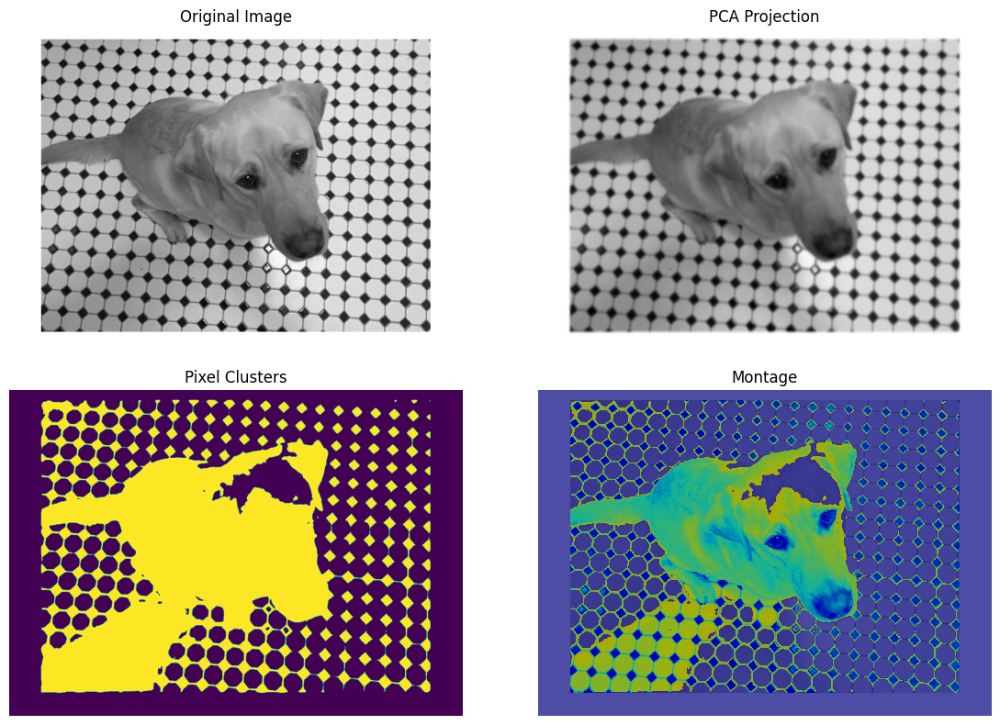

100%|█████████████████████████████████████████████████████████████████████████████████| 60/60 [00:00<00:00, 681.22it/s]


Created 60 features for each pixel
Clustering completed in 0.23152875900268555 seconds.


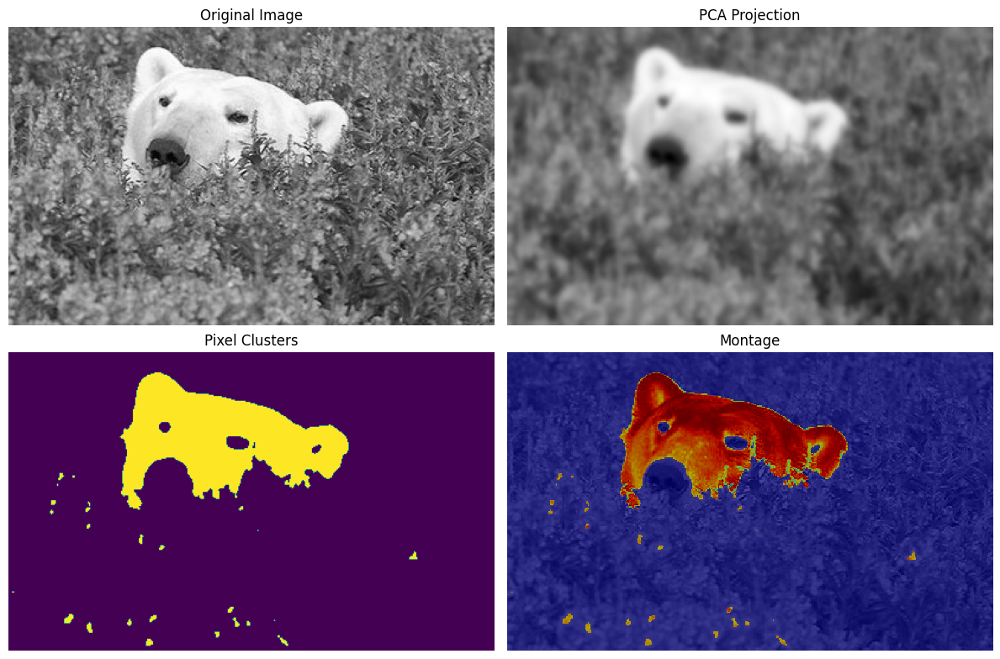

100%|█████████████████████████████████████████████████████████████████████████████████| 70/70 [00:00<00:00, 119.47it/s]


Created 70 features for each pixel
Clustering completed in 1.1670870780944824 seconds.


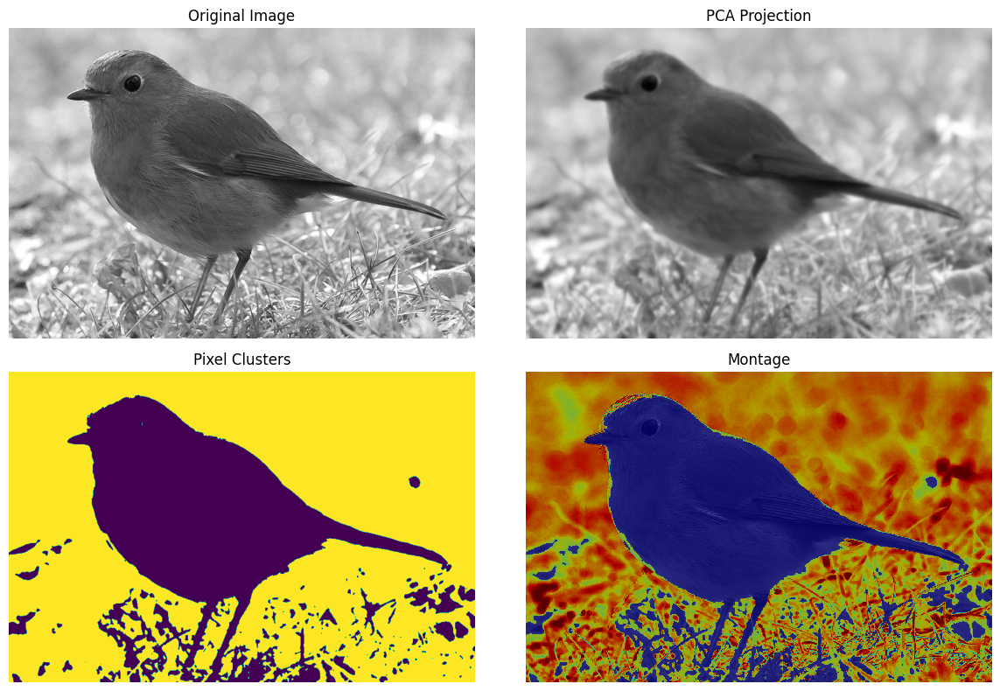

100%|██████████████████████████████████████████████████████████████████████████████████| 70/70 [00:00<00:00, 94.04it/s]


Created 70 features for each pixel
Clustering completed in 1.8009247779846191 seconds.


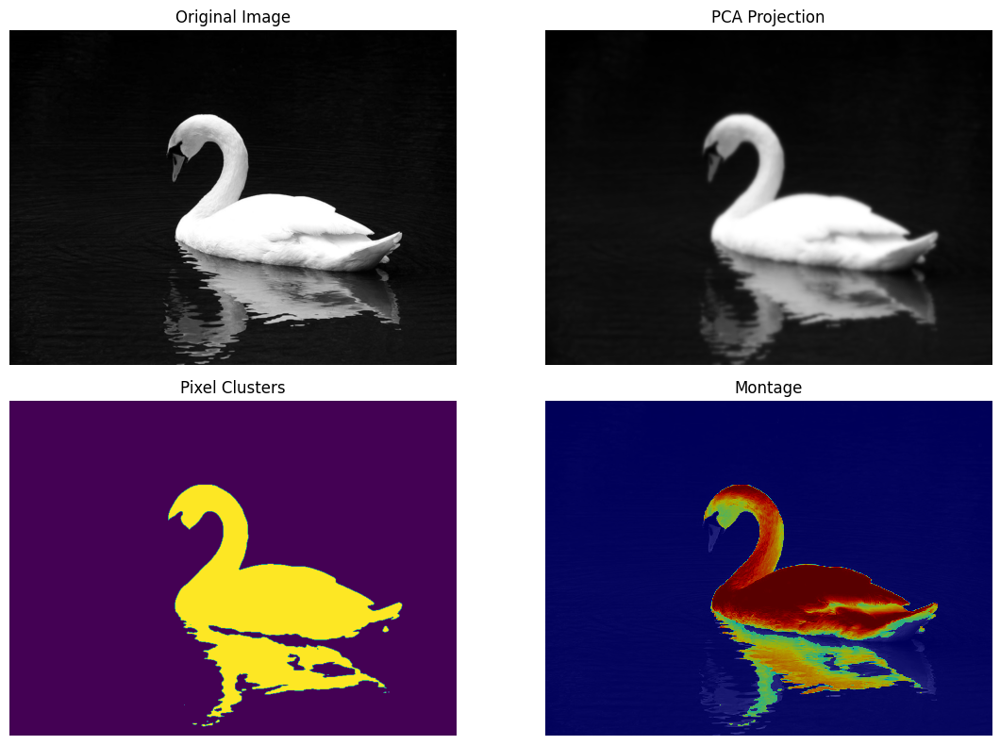

In [45]:
# Control settings
delta_theta = 2 * np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1.0, 2.0])
apply_smoothing = True

image_names = [
    "clownfish",
    "flower",
    "kobi",
    "polar_bear_hiding",
    "robin",
    "swan"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

##### <font color='yellow'>Answer:</font>

Once the sigmas get higher, the image gets smoother, which helps to get rid of noise and details in the background. However, when we increase sigma too much, the edges are no longer distinguishable, leading to worse foreground detection/seperation.
The orientations parameters consist mainly of theta: the step size for the orientations. The bigger the theta, the less angles are analyzed for edge detection, which leads to non-accurate lines along the edges of an object. However, if the theta gets really small, the computation is also more intensive and therefore takes a long time. Thus, setting the theta not too high and not too low is important for seperation and efficiency.

As we can tell, the relatively small sigma settings and small delta step size is very effective for the polar bear, the flower, and the robin. Nevertheless, these settings have a tough time seperating the clown fish and kobi from their background. Using a smaller theta and bigger sigma might help with this.

<a id="question-35"></a>
#### <font color='#FF0000'>Question 35 (4 points)</font>

Experiment with different `sigma` and `theta` settings for the `foreground_background_separation()` function until you achieve reasonable outputs. For each input image, report the parameter settings that work best and provide an explanation for why these settings are effective. 

##### <font color='yellow'>Answer:</font>

100%|███████████████████████████████████████████████████████████████████████████████| 126/126 [00:00<00:00, 221.85it/s]


Created 126 features for each pixel
Clustering completed in 1.0953772068023682 seconds.


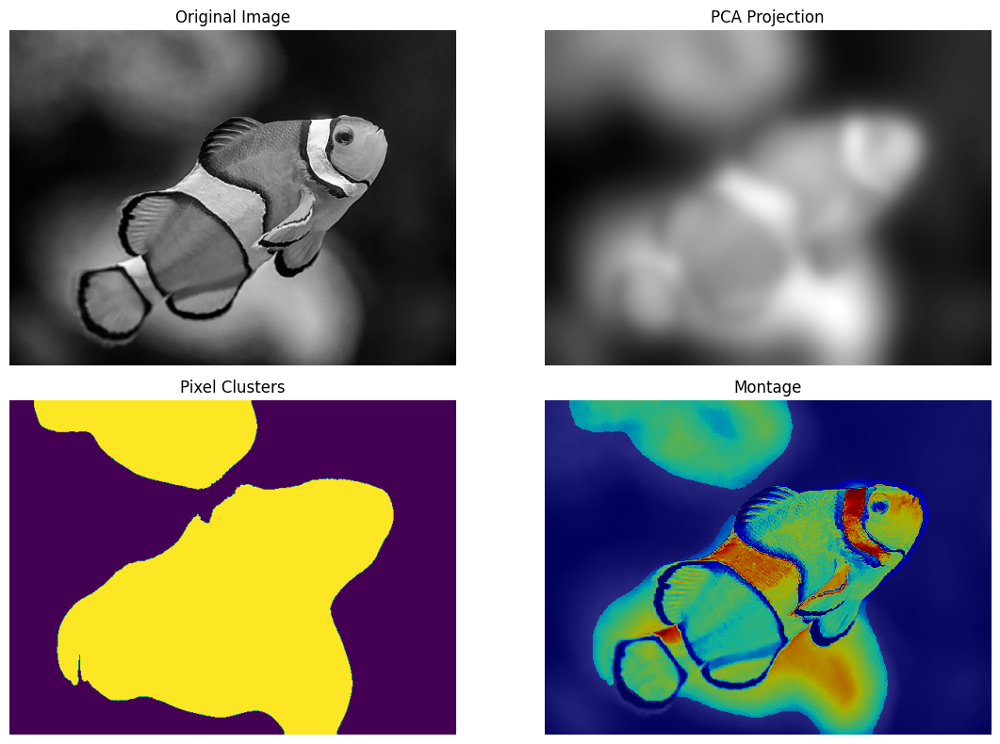

In [46]:
delta_theta = np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([7,15])
apply_smoothing = True

image_names = [
    "clownfish"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|█████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 261.07it/s]


Created 28 features for each pixel
Clustering completed in 0.23580288887023926 seconds.


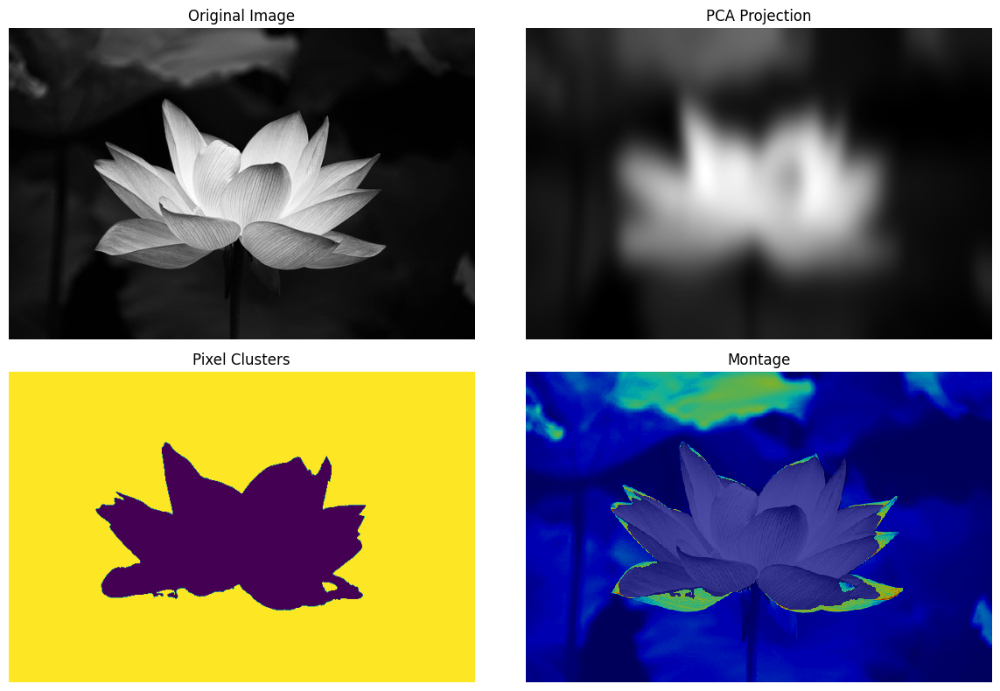

In [47]:
delta_theta = 9*np.pi # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1,11])
apply_smoothing = True

image_names = [
    "flower"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|██████████████████████████████████████████████████████████████████████████████████| 80/80 [00:01<00:00, 57.50it/s]


Created 80 features for each pixel
Clustering completed in 3.1160624027252197 seconds.


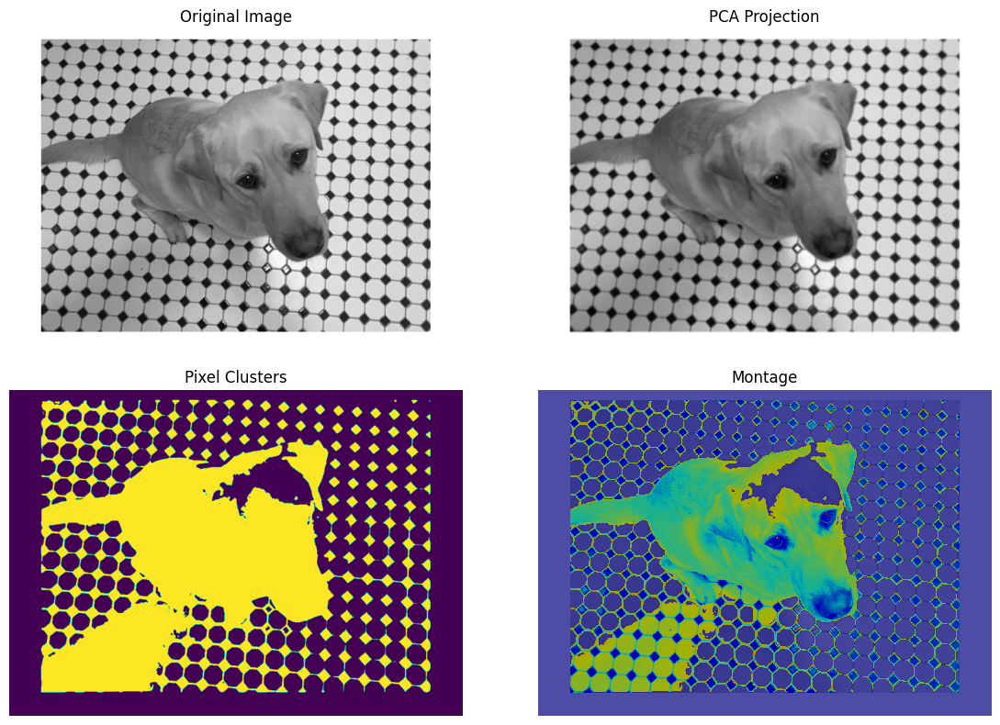

In [48]:
delta_theta = np.pi/4  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1,1.1])
apply_smoothing = True

image_names = [
    "kobi"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|██████████████████████████████████████████████████████████████████████████████| 108/108 [00:00<00:00, 1124.98it/s]


Created 108 features for each pixel
Clustering completed in 0.37357115745544434 seconds.


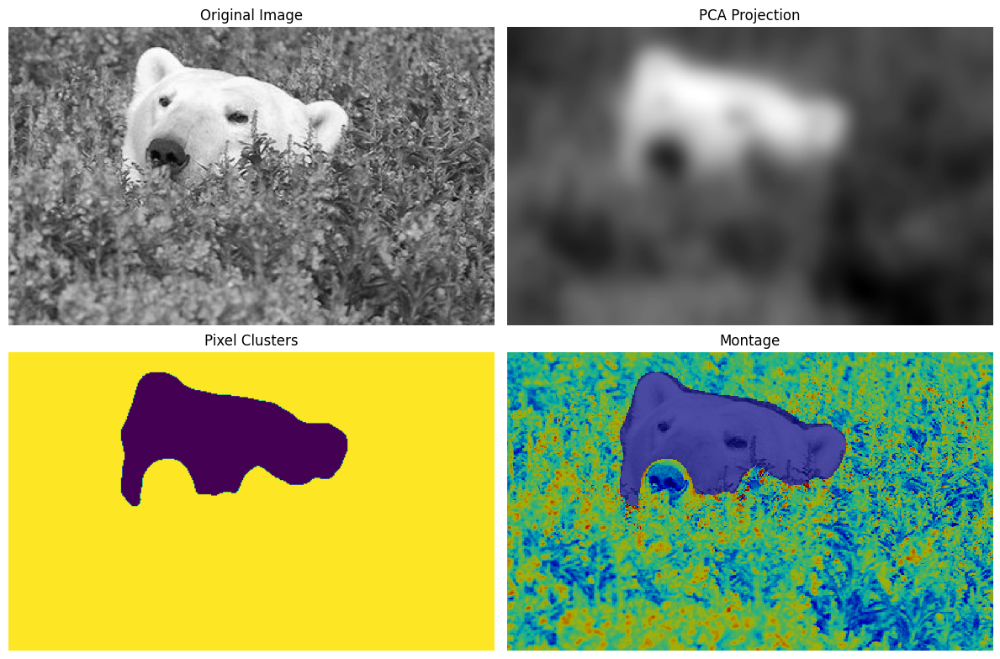

In [49]:
delta_theta = np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([6,10])
apply_smoothing = True

image_names = [
    "polar_bear_hiding"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|███████████████████████████████████████████████████████████████████████████████| 126/126 [00:01<00:00, 114.34it/s]


Created 126 features for each pixel
Clustering completed in 3.7153310775756836 seconds.


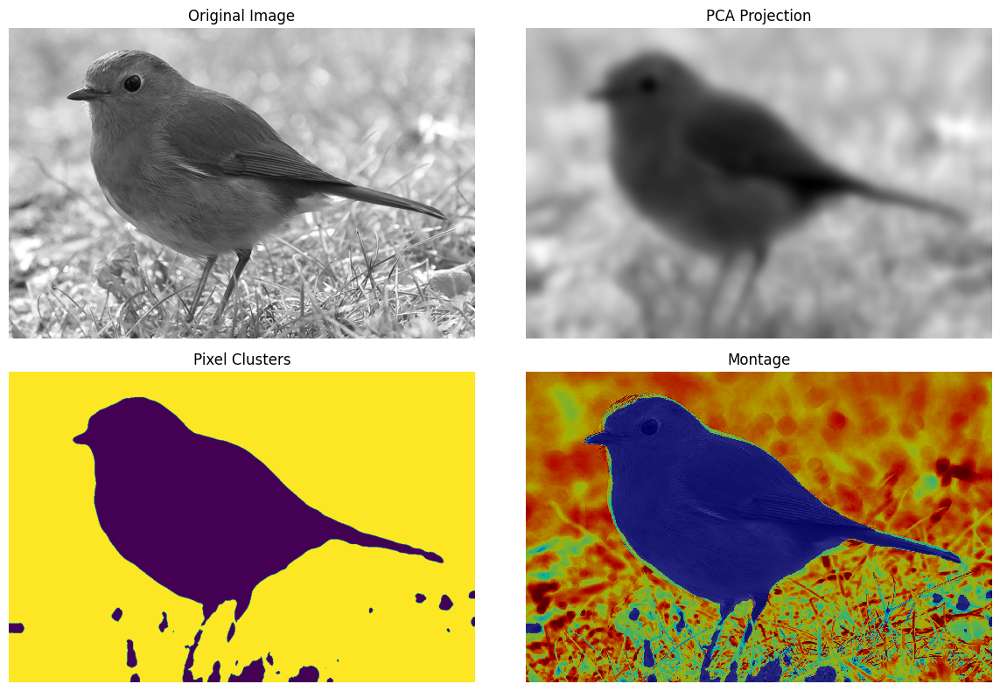

In [50]:
delta_theta = np.pi /8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([7,10])
apply_smoothing = True

image_names = [
    "robin"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|████████████████████████████████████████████████████████████████████████████████| 238/238 [00:02<00:00, 94.83it/s]


Created 238 features for each pixel
Clustering completed in 4.371652364730835 seconds.


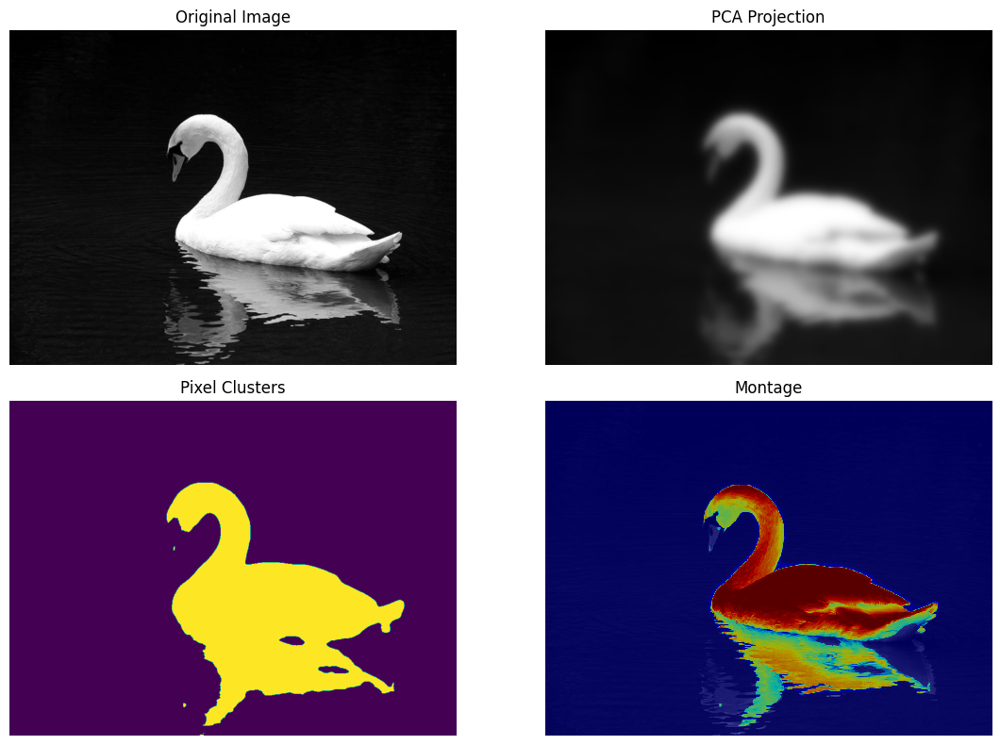

In [51]:
delta_theta = np.pi / 16  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([5,7])
apply_smoothing = True

image_names = [
    "swan"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

We have experimented with different sigmas and thetas. Let us go over all input images and what parameter settings work best:
#### Clown Fish
For the clown fish, we have decided on sigmas 7,15, and theta $\pi/8$. It is very hard to find a good fit for this image, since the background is still considered in the foreground seperation. Using higher sigmas helps smooth the picture, which at least includes the stripes of the clown fish. However, we were not able to get rid of some of the background. We also noticed that decreasing the theta a bit, gives a smoother/closer edge to the clown fish.
#### Flower
For the flower, we have decided on sigmas 1,11, and theta $9\pi$. We have thus increased the sigma quite a lot, because the previous foreground seperation still included some background at the top of the picture. By increasing sigma, we made the image smoother and the detection of the flower easier. We have also increased the theta, because the flower has some shadows and these where excluded if we put the theta too small. This can be due to the fact that we now evaluate the flower at less angles and easily "connect the dots".
#### Kobi
For Kobi, we have decided on sigmas 1,1.1 and theta $\pi/4$. This small sigma range yields the best results, since the foreground seperation tends to think the floor is also foreground, since it is so light. Therefore, the less blurry the image, the clearer the seperation will be. The step size is kept the same, since the accuracy of the edge was okay, and we did not want to decrease the efficiency.
#### Polar bear
For the polar bear, we have decided on sigmas 6,10, and theta $\pi/8$. We decided to inrcease the sigmas in order to also include the eyes of the polar bear in the foreground. The theta was decreased a little bit in order to have a smoother/closer edge around the polar bear.
#### Robin
For the robin, we have decided on sigmas 7,10, and theta $\pi/8$. We decided to increase the sigmas when compared to the previous exercise, because the image still included a lot of grass in the foreground. By smoothing the image, it is easier to detect the main object. The step size is set a little bit smaller compared to the previous exercise. This in order to still closely follow the robin despite increasing the sigmas.
#### Swan
For the swan, we have decided on sigmas 5,7 and theta $\pi/16$. This is a relatively average sigma and a relatively small theta. This sigma is pretty average, since the background of the swan is not complicated: black. The only thing that is hard to filter out is the reflection of the water, and the inclusion of the beak of the swan. By choosing a smaller theta, we try to follow the lines of the swan as close as possible. The average sigmas make sure that we at least get a "smooth" outline of the water, and not wrinkly. Nevertheless, by increasing the sigmas, the quality of the swan decreases too much compared to the exclusion of the reflection. Therefore, we opted for these parameter settings.

<a id="question-36"></a>
#### <font color='#FF0000'>Question 36 (4 points)</font>

After achieving decent separation on all test images, run the script again using the corresponding parameters, but this time set `apply_smoothing = False`. 

Describe what you observe in the output when smoothing is not applied to the magnitude images. Explain why these changes occur and discuss the reasoning behind the smoothing step.

100%|███████████████████████████████████████████████████████████████████████████████| 126/126 [00:00<00:00, 246.61it/s]


Created 126 features for each pixel
Clustering completed in 1.0918798446655273 seconds.


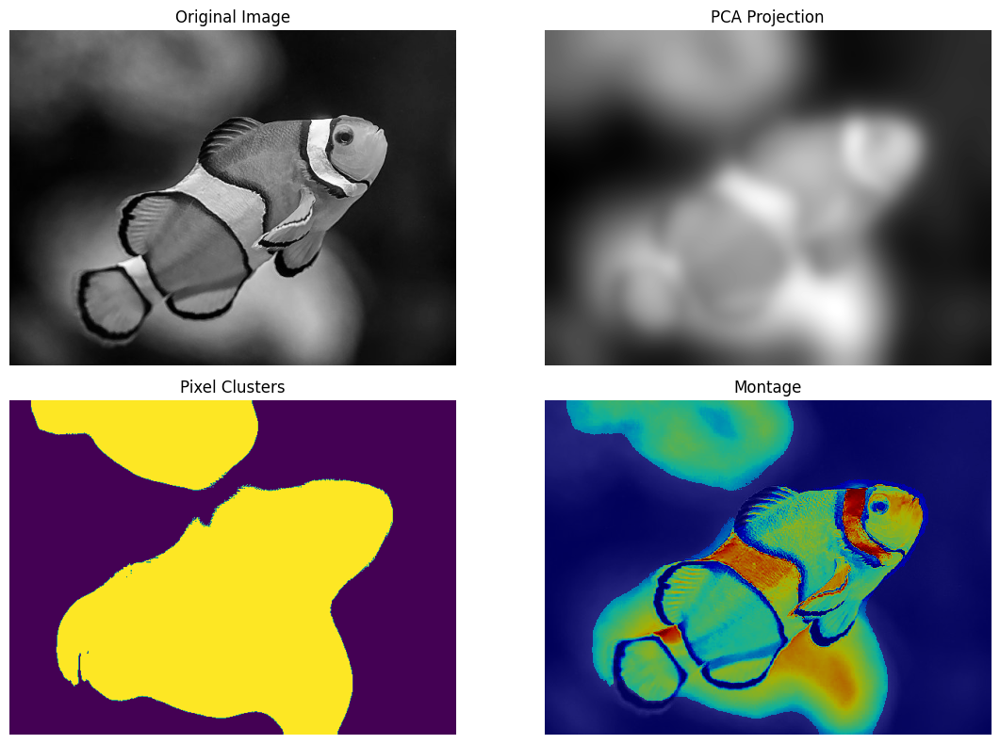

In [52]:
delta_theta = np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([7,15])
apply_smoothing = False

image_names = [
    "clownfish"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|█████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 223.94it/s]


Created 28 features for each pixel
Clustering completed in 0.274616003036499 seconds.


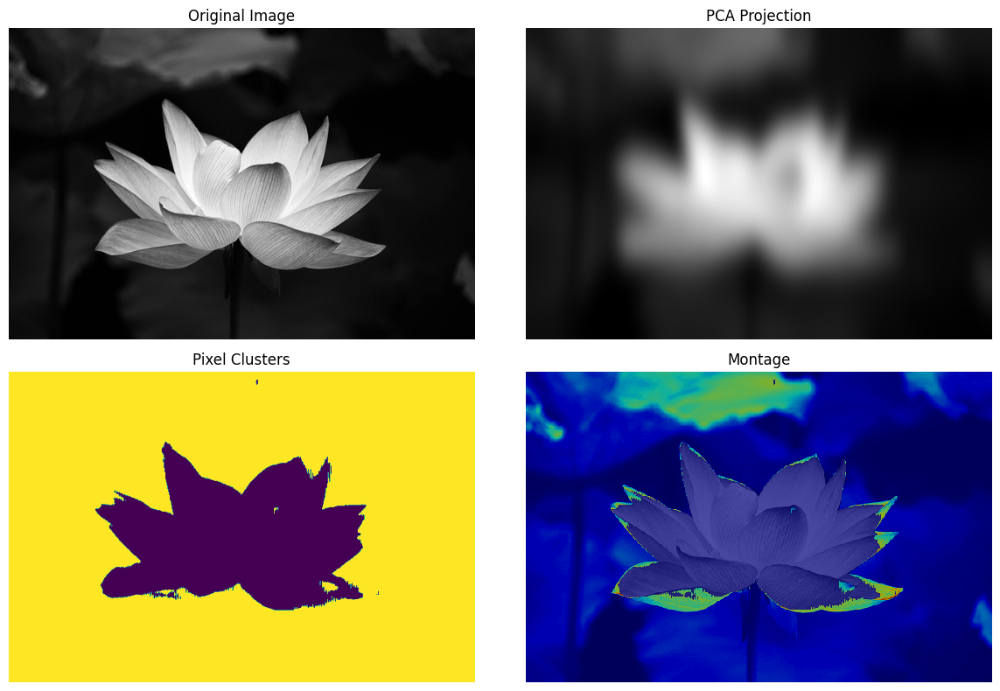

In [53]:
delta_theta = 9*np.pi # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1,11])
apply_smoothing = False

image_names = [
    "flower"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|██████████████████████████████████████████████████████████████████████████████████| 80/80 [00:01<00:00, 59.63it/s]


Created 80 features for each pixel
Clustering completed in 3.7350645065307617 seconds.


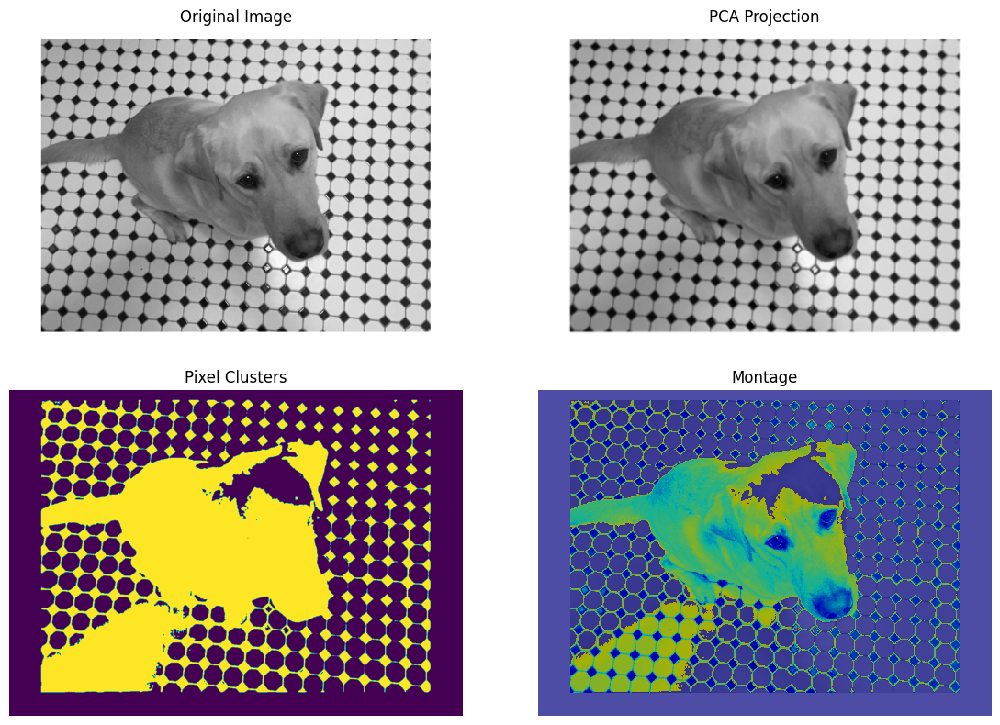

In [54]:
delta_theta = np.pi/4  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1,1.1])
apply_smoothing = False

image_names = [
    "kobi"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|███████████████████████████████████████████████████████████████████████████████| 108/108 [00:00<00:00, 590.61it/s]


Created 108 features for each pixel
Clustering completed in 0.4286212921142578 seconds.


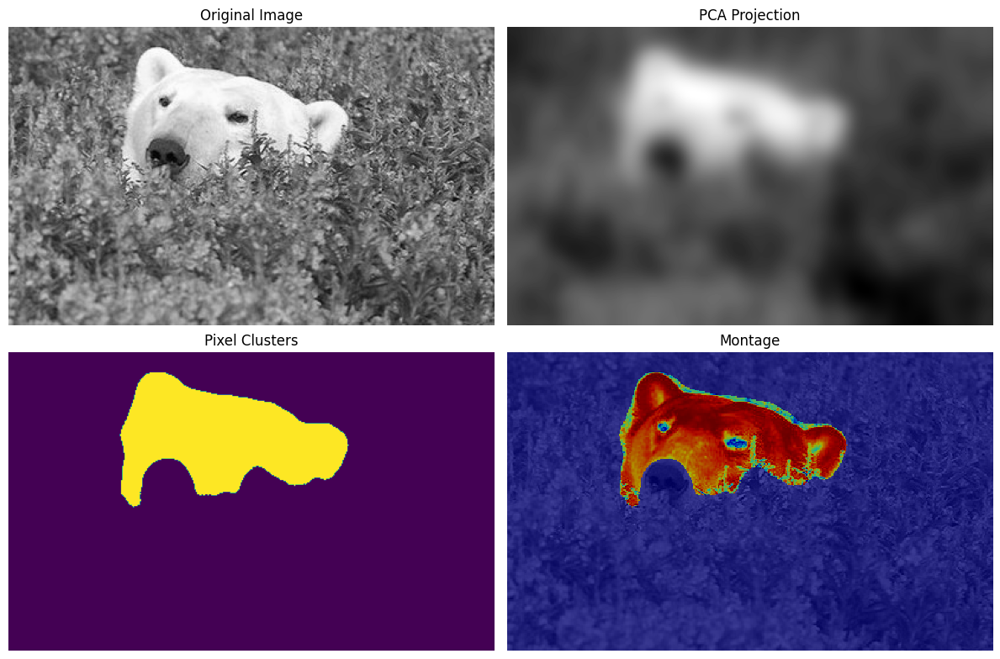

In [55]:
delta_theta = np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([6,10])
apply_smoothing = False

image_names = [
    "polar_bear_hiding"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|████████████████████████████████████████████████████████████████████████████████| 126/126 [00:01<00:00, 68.41it/s]


Created 126 features for each pixel
Clustering completed in 2.3331634998321533 seconds.


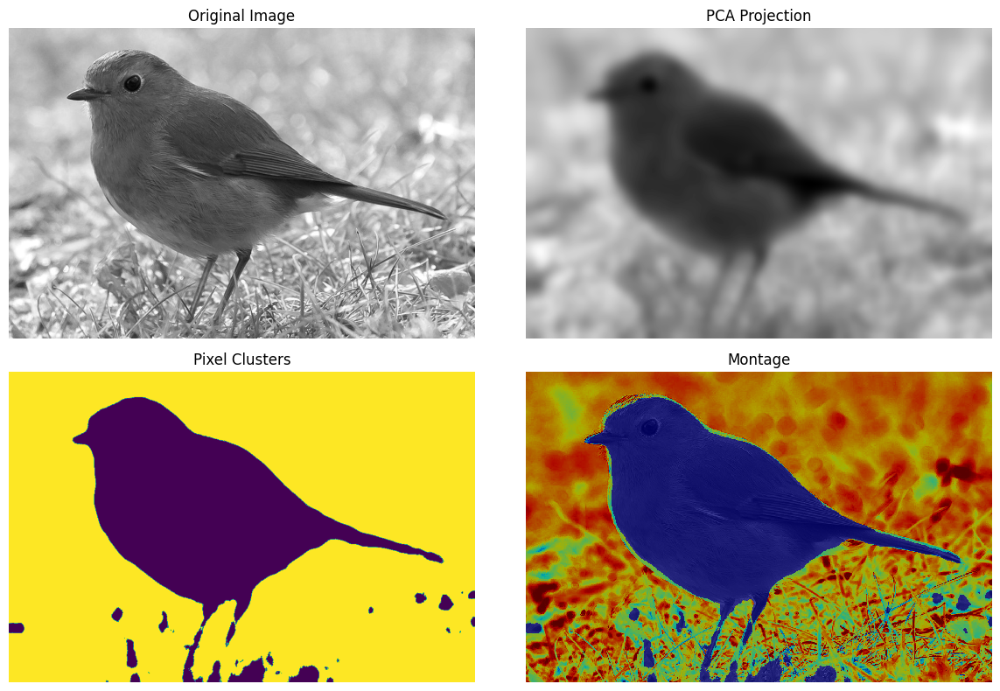

In [56]:
delta_theta = np.pi /8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([7,10])
apply_smoothing = False

image_names = [
    "robin"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

100%|███████████████████████████████████████████████████████████████████████████████| 238/238 [00:01<00:00, 132.66it/s]


Created 238 features for each pixel
Clustering completed in 3.711268186569214 seconds.


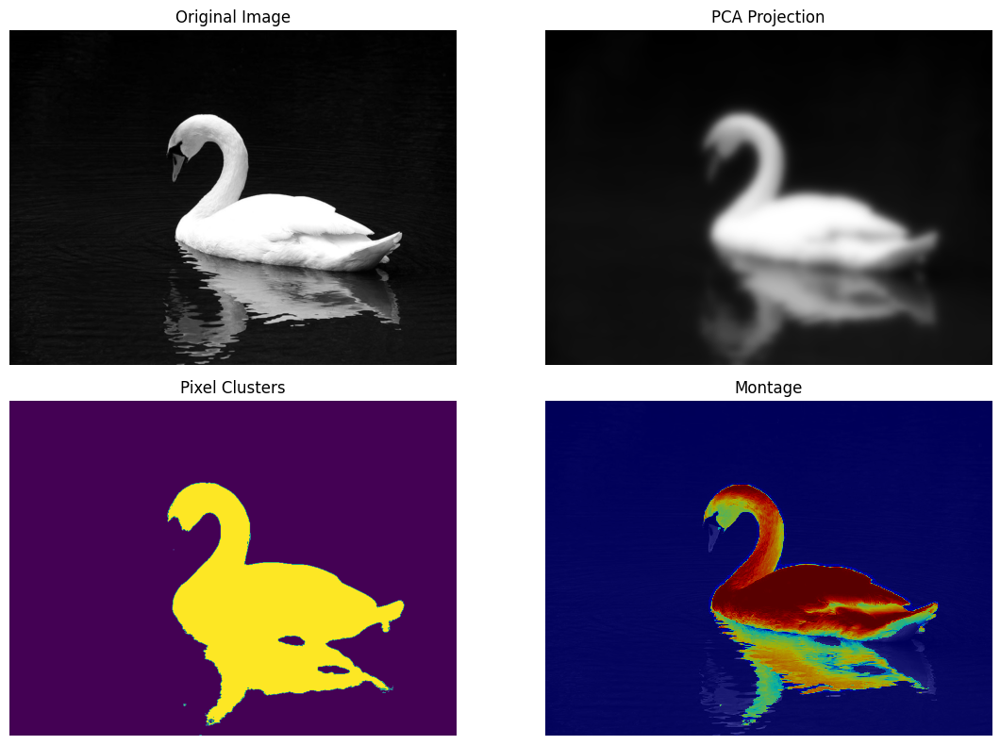

In [57]:
delta_theta = np.pi / 16  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([5,7])
apply_smoothing = False

image_names = [
    "swan"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

##### <font color='yellow'>Answer:</font>

Once we remove smoothing, we notice that the edges around the foreground are less smooth. In some cases this is not a bad effect, since the objects are not smooth to begin with. For example, the polar bear has fur, which makes the foreground without smoothing align better. Nevertheless, for some images, this non-smoothing is not desirable. For example, the flower is a smooth surface. Now it seperates the foreground almost like a feather, which we do not want. Moreover, we want to conclude this question by saying that turning the smoothing off does not cause major changes, which can also be attributed to our pretty high resolution of images.

<a id="section-x"></a>
### **Section X: Individual Contribution Report *(Mandatory)***

Because we want each student to contribute fairly to the submitted work, we ask you to fill out the textcells below. Write down your contribution to each of the assignment components in percentages. Naturally, percentages for one particular component should add up to 100% (e.g. 30% - 30% - 40%). No further explanation has to be given.

| Name | Contribution on Research | Contribution on Programming | Contribution on Writing |
| -------- | ------- | ------- | ------- |
| Emma | 33 % | 33 % | 34 % |
| Jasper | 33 % | 34 % | 33 % |
| Platon | 34 % | 33 % | 33 % |

### - End of Notebook -